# Import Packages

In [1]:
import pandas as pd
import networkx as nx
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
from pyvis.network import Network
from netgraph import Graph
import distinctipy
from julia import Julia
from matplotlib.lines import Line2D
import matplotlib.font_manager as fm

# Modularity Formulations

In [2]:
jl = Julia(runtime='C:/Users/blake/AppData/Local/Programs/Julia 1.5.3/bin/julia.exe')

julia_code = """
using JuMP, Gurobi, LinearAlgebra

function make_modules(A,n_m,topic_sizes,max_size,min_size,review,review_sizes,time_limit)
    # A = topic dependency matrix
    # n_m = number of modules
    # topic_sizes = sizes of topics
    # max_size = maximum size of module
    # min_size = minimum size of module
    # review = binary review matrix if topic i is reviewed to teach topic j
    # review_sizes = size of reviewing topic i  to teach topic j
    
    n_t = length(A[1,:])
    m = sum(A)

    mm=Model(optimizer_with_attributes(Gurobi.Optimizer,"TimeLimit"=>time_limit))

    @variable(mm, x[1:n_t,1:n_m], Bin) # module population matrix

    @constraint(mm, [i in 1:n_t], sum(x[i,p] for p in 1:n_m)==1) # each topic is assigned to one modules
    @constraint(mm, [p in 1:n_m], sum(x[i,p] for i in 1:n_t)>=1) # ecach module has at least one topic
    
    @variable(mm, module_size[1:n_m]) # size of each module
    @variable(mm, r[1:n_t,1:n_t,1:n_m], Bin) # if a topic i is reviewed in module p to teach topic j
    
    @constraint(mm, [i in 1:n_t,j in 1:n_t,p in 1:n_m], r[i,j,p] == x[i,p] * (1 - x[j,p]) * review[j,i])
    @constraint(mm, [p in 1:n_m], module_size[p] == sum(x[i,p] * topic_sizes[i] for i in 1:n_t) + sum(review_sizes[i,j] * r[i,j,p] for j in 1:n_t for i in 1:n_t if i != j)) # calculate the size of each module
    @constraint(mm, [p in 1:n_m], min_size <= module_size[p] <= max_size) # each module is size restricted

    @objective(mm, Max, 1/2/m*sum(A[i,j]*x[i,t]*x[j,t] for i in 1:n_t for j in 1:n_t for t in 1:n_m)) # maximize modularity 
    
    optimize!(mm)

    X = value.(x)
    X_bool = X .> 0
    groups = [findall(X_bool[:,p]) for p in 1:n_m]
    modules = convert(Array{Any}, [convert(Array{Any},group) for group in groups])

    R = value.(r)
    R_bool = R .> 0.1
    
    reviews = []
    for p in 1:n_m
        for i in 1:n_t
            for j in 1:n_t
                if R_bool[i, j, p]
                    push!(reviews, (i,j,p))
                end
            end
        end
    end

    modularity = JuMP.objective_value(mm)

    return (modules, modularity, reviews)

end

function make_sequenced_modules(A,n_m,topic_sizes,max_size,min_size,review,review_sizes,time_limit)
    # A = topic dependency matrix
    # n_m = number of modules
    # topic_sizes = sizes of topics
    # max_size = maximum size of module
    # min_size = minimum size of module
    # review = binary review matrix if topic i is reviewed to teach topic j
    # review_sizes = size of reviewing topic i  to teach topic j

    n_t = length(A[1,:]) # number of topics
    m = sum(A)
    
    if (n_t - n_m) % 2 == 0
        M = ((n_t - n_m + 2) / 2)^2
    else
        M = ((n_t - n_m + 1) / 2)^2 + ((n_t - n_m + 1) / 2)
    end

    mm=Model(optimizer_with_attributes(Gurobi.Optimizer,"TimeLimit"=>time_limit))

    @variable(mm, x[1:n_t,1:n_m], Bin) # module population matrix

    @constraint(mm, [i in 1:n_t], sum(x[i,p] for p in 1:n_m)==1) # each topic is assigned to one modules
    @constraint(mm, [p in 1:n_m], sum(x[i,p] for i in 1:n_t)>=1) # ecach module has at least one topic
    
    @variable(mm, module_size[1:n_m]) # size of each module
    @variable(mm, r[1:n_t,1:n_t,1:n_m], Bin) # if a topic i is reviewed in module p to teach topic j
    
    @constraint(mm, [i in 1:n_t,j in 1:n_t,p in 1:n_m], r[i,j,p] == x[i,p] * (1 - x[j,p]) * review[j,i])
    @constraint(mm, [p in 1:n_m], module_size[p] == sum(x[i,p] * topic_sizes[i] for i in 1:n_t) + sum(review_sizes[i,j] * r[i,j,p] for j in 1:n_t for i in 1:n_t if i != j)) # calculate the size of each module
    @constraint(mm, [p in 1:n_m], min_size <= module_size[p] <= max_size) # each module is size restricted

    @objective(mm, Max, 1/2/m*sum(A[i,j]*x[i,t]*x[j,t] for i in 1:n_t for j in 1:n_t for t in 1:n_m)) # maximize modularity 

    @variable(mm, B[1:n_m,1:n_m]) # matrix of number of edges between modules

    @constraint(mm, B .== transpose(x)*A*x)

    @variable(mm, C[1:n_m,1:n_m], Bin) # matrix representing directed edges between modules

    for p in 1:n_m
        for q in 1:n_m
            if p != q
                @constraint(mm, C[p,q] >= B[p,q] / M)
                @constraint(mm, C[p,q] <= B[p,q])
            else
                @constraint(mm, C[p,q] == 0)
            end
        end
    end

    @variable(mm, D[1:n_m,1:n_m,1:n_m]) # matrix showing the modules accessed depending on the number of steps

    for L in 1:n_m
        for p in 1:n_m
            for q in 1:n_m
                if L == 1
                    @constraint(mm, D[p, q, L] == C[p, q])
                else
                    @constraint(mm, D[p, q, L] == sum(D[p, k, L-1] * C[k, q] for k in 1:n_m))
                end
            end
        end
    end

    @variable(mm, E[1:n_m,1:n_m]) # matrix showing paths from module to module

    @constraint(mm, E .== sum(D[:,:,i] for i in 1:n_m)) 

    @variable(mm, F[1:n_m,1:n_m], Bin) # matrix representing if there is a path from one node to another

    for p in 1:n_m
        for q in 1:n_m
            @constraint(mm, F[p,q] >= E[p,q] / 2^(n_m-2))
            @constraint(mm, F[p,q] <= E[p,q])
        end
    end

    for p in 1:n_m
        for q in 1:n_m
            @constraint(mm, F[p,q] + F[q,p] <= 1)
        end
    end

    optimize!(mm)

    X = value.(x)
    X_bool = X .> 0
    groups = [findall(X_bool[:,p]) for p in 1:n_m]
    modules = convert(Array{Any}, [convert(Array{Any},group) for group in groups])

    R = value.(r)
    R_bool = R .> 0.1
    
    reviews = []
    for p in 1:n_m
        for i in 1:n_t
            for j in 1:n_t
                if R_bool[i, j, p]
                    push!(reviews, (i,j,p))
                end
            end
        end
    end

    modularity = JuMP.objective_value(mm)

    return (modules, modularity, reviews)
    
end

function make_sequenced_modules_initial(A,n_m,topic_sizes,max_size,min_size,review,review_sizes,time_limit,x_initial)
    # A = topic dependency matrix
    # n_m = number of modules
    # topic_sizes = sizes of topics
    # max_size = maximum size of module
    # min_size = minimum size of module
    # review = binary review matrix if topic i is reviewed to teach topic j
    # review_sizes = size of reviewing topic i  to teach topic j

    n_t = length(A[1,:]) # number of topics
    m = sum(A)
    
    if (n_t - n_m) % 2 == 0
        M = ((n_t - n_m + 2) / 2)^2
    else
        M = ((n_t - n_m + 1) / 2)^2 + ((n_t - n_m + 1) / 2)
    end

    mm=Model(optimizer_with_attributes(Gurobi.Optimizer,"TimeLimit"=>time_limit))

    @variable(mm, x[1:n_t,1:n_m], Bin) # module population matrix

    @constraint(mm, [i in 1:n_t], sum(x[i,p] for p in 1:n_m)==1) # each topic is assigned to one modules
    @constraint(mm, [p in 1:n_m], sum(x[i,p] for i in 1:n_t)>=1) # ecach module has at least one topic
    
    @variable(mm, module_size[1:n_m]) # size of each module
    @variable(mm, r[1:n_t,1:n_t,1:n_m], Bin) # if a topic i is reviewed in module p to teach topic j
    
    @constraint(mm, [i in 1:n_t,j in 1:n_t,p in 1:n_m], r[i,j,p] == x[i,p] * (1 - x[j,p]) * review[j,i])
    @constraint(mm, [p in 1:n_m], module_size[p] == sum(x[i,p] * topic_sizes[i] for i in 1:n_t) + sum(review_sizes[i,j] * r[i,j,p] for j in 1:n_t for i in 1:n_t if i != j)) # calculate the size of each module
    @constraint(mm, [p in 1:n_m], min_size <= module_size[p] <= max_size) # each module is size restricted

    @objective(mm, Max, 1/2/m*sum(A[i,j]*x[i,t]*x[j,t] for i in 1:n_t for j in 1:n_t for t in 1:n_m)) # maximize modularity 

    @variable(mm, B[1:n_m,1:n_m]) # matrix of number of edges between modules

    @constraint(mm, B .== transpose(x)*A*x)

    @variable(mm, C[1:n_m,1:n_m], Bin) # matrix representing directed edges between modules

    for p in 1:n_m
        for q in 1:n_m
            if p != q
                @constraint(mm, C[p,q] >= B[p,q] / M)
                @constraint(mm, C[p,q] <= B[p,q])
            else
                @constraint(mm, C[p,q] == 0)
            end
        end
    end

    @variable(mm, D[1:n_m,1:n_m,1:n_m]) # matrix showing the modules accessed depending on the number of steps

    for L in 1:n_m
        for p in 1:n_m
            for q in 1:n_m
                if L == 1
                    @constraint(mm, D[p, q, L] == C[p, q])
                else
                    @constraint(mm, D[p, q, L] == sum(D[p, k, L-1] * C[k, q] for k in 1:n_m))
                end
            end
        end
    end

    @variable(mm, E[1:n_m,1:n_m]) # matrix showing paths from module to module

    @constraint(mm, E .== sum(D[:,:,i] for i in 1:n_m)) 

    @variable(mm, F[1:n_m,1:n_m], Bin) # matrix representing if there is a path from one node to another

    for p in 1:n_m
        for q in 1:n_m
            @constraint(mm, F[p,q] >= E[p,q] / 2^(n_m-2))
            @constraint(mm, F[p,q] <= E[p,q])
        end
    end

    for p in 1:n_m
        for q in 1:n_m
            @constraint(mm, F[p,q] + F[q,p] <= 1)
        end
    end
    
    for i in 1:n_t
        for p in 1:n_m
            set_start_value(x[i,p],x_initial[i,p])
        end
    end

    optimize!(mm)

    X = value.(x)
    X_bool = X .> 0
    groups = [findall(X_bool[:,p]) for p in 1:n_m]
    modules = convert(Array{Any}, [convert(Array{Any},group) for group in groups])

    R = value.(r)
    R_bool = R .> 0
    
    reviews = []
    for p in 1:n_m
        for i in 1:n_t
            for j in 1:n_t
                if R_bool[i, j, p]
                    push!(reviews, (i,j,p))
                end
            end
        end
    end

    modularity = JuMP.objective_value(mm)

    return (modules, modularity, reviews)
    
end

function make_LPA_sequenced_modules(A,n_m,topic_sizes,max_size,min_size,review,review_sizes,time_limit)
    # A = topic dependency matrix
    # n_m = number of modules
    # topic_sizes = sizes of topics
    # max_size = maximum size of module
    # min_size = minimum size of module
    # review = binary review matrix if topic i is reviewed to teach topic j
    # review_sizes = size of reviewing topic i  to teach topic j

    n_t = length(A[1,:])
    m = sum(A)

    mm=Model(optimizer_with_attributes(Gurobi.Optimizer,"TimeLimit"=>time_limit))

    @variable(mm, x[1:n_t,1:n_m], Bin) # module population matrix

    @constraint(mm, [i in 1:n_t], sum(x[i,p] for p in 1:n_m)==1) # each topic is assigned to one modules
    @constraint(mm, [p in 1:n_m], sum(x[i,p] for i in 1:n_t)>=1) # ecach module has at least one topic
    
    @variable(mm, module_size[1:n_m]) # size of each module
    @variable(mm, r[1:n_t,1:n_t,1:n_m], Bin) # if a topic i is reviewed in module p to teach topic j
    
    @constraint(mm, [i in 1:n_t,j in 1:n_t,p in 1:n_m], r[i,j,p] == x[i,p] * (1 - x[j,p]) * review[i,j])
    @constraint(mm, [p in 1:n_m], module_size[p] == sum(x[i,p] * topic_sizes[i] for i in 1:n_t) + sum(review_sizes[i,j] * r[i,j,p] for j in 1:n_t for i in 1:n_t if i != j)) # calculate the size of each module
    @constraint(mm, [p in 1:n_m], min_size <= module_size[p] <= max_size) # each module is size restricted

    @objective(mm, Max, 1/2/m*sum(A[i,j]*x[i,p]*x[j,p] for i in 1:n_t for j in 1:n_t for p in 1:n_m)) # maximize modularity 
    
    @variable(mm, 1 <= y[1:n_t] <= n_m, Int) # module number
    
    @constraint(mm, [i in 1:n_t], y[i] == sum(p * x[i,p] for p in 1:n_m))

    for p in 1:n_m
        for i in 1:n_t
            for j in 1:n_t
                if i < j
                    @constraint(mm, y[i] <= y[j]) # force order of modules
                end  
            end
        end
    end

    optimize!(mm)

    X = value.(x)
    X_bool = X .> 0.5
    groups = [findall(X_bool[:,p]) for p in 1:n_m]
    modules = convert(Array{Any}, [convert(Array{Any},group) for group in groups])

    R = value.(r)
    R_bool = R .> 0
    
    reviews = []
    for p in 1:n_m
        for i in 1:n_t
            for j in 1:n_t
                if R_bool[i, j, p]
                    push!(reviews, (i,j,p))
                end
            end
        end
    end

    modularity = JuMP.objective_value(mm)

    return (modules, modularity, reviews)
    
end
"""

jl.eval(julia_code)

C:\Users\blake\Anaconda3\lib\site-packages\julia\core.py:709: FutureWarning: Accessing `Julia().<name>` to obtain Julia objects is deprecated.  Use `from julia import Main; Main.<name>` or `jl = Julia(); jl.eval('<name>')`.
  warnings.warn(


<PyCall.jlwrap make_LPA_sequenced_modules>

# Load and Process Data to Build Graph

In [3]:
data = pd.read_csv('Data/Core Courses.csv') # load all course data
courses = data["Course"].tolist() # all course names
course_names = data["Name"].tolist()

course_names = dict(zip(courses,course_names)) # dictionary of course names
graph = nx.DiGraph() # initialize an empty directed graph

topic_sizes = {} # dictionary of topic sizes
topic_courses = {} # dictionary of store topic-course mapping
review_sizes = {} # dictionary of review times between topics in specific courses
reviewed_topics = [] # list of topics that are reviewed
course_topics = {} # dictionary of all new topics introduced in a course
topic_course_sizes = {} # size of each topic in each course
simple_review_sizes = {} # dictionary of review sizes not indexed by course
weighted_review_sizes = {} # simple review size / number of topic sucessors in course it is reviewed in

for p,course in enumerate(courses):
    course_data = pd.read_csv(f'Data/{course}.csv', encoding='unicode_escape') # get course data
    new_topics = []
    for index, row in course_data.iterrows(): # iterate over each row
        i = row['Topic']
        edges_to = row['Edges To']  
        size = row['Size']
        
        if i in topic_sizes:
            reviewed_topics.append(i)
        
        if not graph.has_node(i): # add node for topic if not already present
            graph.add_node(i, size=size)

        if pd.notnull(edges_to): # check if there are any edges to 
            edges_to = [topic.strip() for topic in edges_to.split(';')] # split edges_to
            num_rev = len(edges_to)

            for j in edges_to: # iterate over edges to 
                graph.add_edge(i, j) # add edge from i to j

                if i in topic_sizes: # add review time only if the topic has been taught in a previous course
                    review_sizes[i,j,p] = size
                    simple_review_sizes[i,j] = size
                    weighted_review_sizes[i,j] = size/num_rev

        if i not in topic_courses: # add info for a new topic 
            topic_courses[i] = [course]
            topic_sizes[i] = size
            new_topics.append(i)
            topic_course_sizes[i] = [size]
        else:
            topic_courses[i].append(course)
            topic_course_sizes[i].append(size)
            
    course_topics[course] = new_topics

reviewed_topics = list(set(reviewed_topics))

inter_data = pd.read_csv('Data/Inter Connections.csv', encoding='unicode_escape') 

for index, row in inter_data.iterrows(): # add inter edges
    i = row['Topic']
    if i in topic_sizes.keys():
        edges_to = row['Edges To']
        if pd.notnull(edges_to): # check if there are any edges to
            edges_to = [topic.strip() for topic in edges_to.split(';')] # split edges_to 
            for j in edges_to: # iterate over edges_to
                if j in topic_sizes.keys():
                    graph.add_edge(i,j) # add edge from topic i to topic j
            
if not nx.is_directed_acyclic_graph(graph): # check if graph is directed and acyclic
    print("Not directed acyclic")

# Functions

In [4]:
def make_modules(n_m, max_size, min_size, time_limit): # make n_m modules of a specific size 
    A = nx.to_numpy_array(graph)
    nodes = list(graph.nodes(data=False))
    n_t = len(nodes)
    sizes = [topic_sizes[i] for i in nodes]
    node_dict = dict(zip(range(1,n_t+1),nodes)) # dictionary used for communication between python and julia

    # rewrite data for julia format
    review = np.zeros([n_t,n_t])
    review_size = np.zeros([n_t,n_t])
    for ii,i in enumerate(nodes):
        for jj, j in enumerate(nodes):
            if (i,j) in weighted_review_sizes.keys():
                review[jj,ii] = 1
                review_size[ii,jj] = weighted_review_sizes[i,j] 

    julia_A = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in A) + "]"
    julia_review = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in review) + "]"
    julia_review_size = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in review_size) + "]"

    (modules,modularity,reviews) = jl.eval(f"make_modules({julia_A},{n_m},{sizes},{max_size},{min_size},{julia_review},{julia_review_size},{time_limit})") # send to julia
    
    # rewrite results for python format
    review_list = []
    for review in reviews:
        review_list.append([node_dict[review[0]],node_dict[review[1]]])
                    
    for i in range(len(modules)):
            for j in range(len(modules[i])):
                    modules[i][j] = node_dict[modules[i][j]]
                    
    return (modules,modularity,review_list)

def make_sequenced_modules(n_m, max_size, min_size, time_limit): # make sequenced modules of a specific size
    A = nx.to_numpy_array(graph)
    nodes = list(graph.nodes(data=False))
    n_t = len(nodes)
    sizes = [topic_sizes[i] for i in nodes]
    node_dict = dict(zip(range(1,n_t+1),nodes)) # dictionary used for communication between python and julia
    
    # rewrite data for julia format
    review = np.zeros([n_t,n_t])
    review_size = np.zeros([n_t,n_t])
    for ii,i in enumerate(nodes):
        for jj, j in enumerate(nodes):
            if (i,j) in weighted_review_sizes.keys():
                review[jj,ii] = 1
                review_size[ii,jj] = weighted_review_sizes[i,j] 

    julia_A = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in A) + "]"
    julia_review = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in review) + "]"
    julia_review_size = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in review_size) + "]"

    (modules,modularity,reviews) = jl.eval(f"make_sequenced_modules({julia_A},{n_m},{sizes},{max_size},{min_size},{julia_review},{julia_review_size},{time_limit})") # send to julia
    
    # rewrite results for python format
    review_list = []
    for review in reviews:
        review_list.append([node_dict[review[0]],node_dict[review[1]]])
                    
    for i in range(len(modules)):
            for j in range(len(modules[i])):
                    modules[i][j] = node_dict[modules[i][j]]
                    
    return (modules,modularity,review_list)

def make_sequenced_modules_initial(n_m, max_size, min_size, time_limit): # make sequenced modules of a specific size using the current courses as an initial solution for optimization (modules sizes must be outside of 1 - 5 credits)
    A = nx.to_numpy_array(graph)
    nodes = list(graph.nodes(data=False))
    n_t = len(nodes)
    sizes = [topic_sizes[i] for i in nodes]
    node_dict = dict(zip(range(1,n_t+1),nodes)) # dictionary used for communication between python and julia

    # rewrite data for julia format
    review = np.zeros([n_t,n_t])
    review_size = np.zeros([n_t,n_t])
    for ii,i in enumerate(nodes):
        for jj, j in enumerate(nodes):
            if (i,j) in weighted_review_sizes.keys():
                review[jj,ii] = 1
                review_size[ii,jj] = weighted_review_sizes[i,j] 
    
    x_initial = np.zeros((n_t,len(courses)))
    for p,module in enumerate(list(course_topics.values())):
        for ii, i in enumerate(nodes):
            if i in module:
                x_initial[ii,p] = 1

    julia_A = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in A) + "]"
    julia_review = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in review) + "]"
    julia_review_size = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in review_size) + "]"
    julia_x_initial = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in x_initial) + "]"

    (modules,modularity,reviews) = jl.eval(f"make_sequenced_modules_initial({julia_A},{n_m},{sizes},{max_size},{min_size},{julia_review},{julia_review_size},{time_limit},{julia_x_initial})") # send to julia
    
    # rewrite results for python format
    review_list = []
    for review in reviews:
        review_list.append([node_dict[review[0]],node_dict[review[1]]])
                    
    for i in range(len(modules)):
            for j in range(len(modules[i])):
                    modules[i][j] = node_dict[modules[i][j]]
                    
    return (modules,modularity,review_list)

def make_partitioned_sequenced_modules(max_size, min_size, time_limit_guess,time_limit): # make sequenced modules of a specific size using partitions to create an intial sultion for optimization
    partitions = [['CBE 150', 'CBE 250', 'CBE 255', 'CBE 310', 'CBE 311'],['CBE 320', 'CBE 324', 'CBE 326', 'CBE 426'],['CBE 430','CBE 450', 'CBE 470', 'CBE 424']]
    
    initial_modules = []
    for t,partition in enumerate(partitions): # solve each partition
        nodes = [i for i in graph.nodes() if topic_courses[i][0] in partition]
        subgraph = graph.subgraph(nodes)
        
        A = nx.to_numpy_array(subgraph)
        nodes = list(subgraph.nodes(data=False))
        n_t = len(nodes)
        sizes = [topic_sizes[i] for i in nodes]
        node_dict = dict(zip(range(1,n_t+1),nodes)) # dictionary used for communication between python and julia

        # rewrite data for julia format
        review = np.zeros([n_t,n_t])
        review_size = np.zeros([n_t,n_t])
        for ii,i in enumerate(nodes):
            for jj, j in enumerate(nodes):
                if (i,j) in weighted_review_sizes.keys():
                    review[jj,ii] = 1
                    review_size[ii,jj] = weighted_review_sizes[i,j] 

        julia_A = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in A) + "]"
        julia_review = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in review) + "]"
        julia_review_size = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in review_size) + "]"

        (modules,modularity,reviews) = jl.eval(f"make_sequenced_modules({julia_A},{len(partition)},{sizes},{max_size*0.8},{min_size*1.2},{julia_review},{julia_review_size},{time_limit_guess})")
        
        # rewrite results for python format
        review_list = []
        for review in reviews:
            review_list.append([node_dict[review[0]],node_dict[review[1]]])

        for i in range(len(modules)):
                for j in range(len(modules[i])):
                        modules[i][j] = node_dict[modules[i][j]]
                        
        for module in modules:
            initial_modules.append(module)
    
    # work on whole graph now
    A = nx.to_numpy_array(graph)
    nodes = list(graph.nodes(data=False))
    n_t = len(nodes)
    sizes = [topic_sizes[i] for i in nodes]
    node_dict = dict(zip(range(1,n_t+1),nodes))
    n_m = len(courses)
    
    # rewrite data for julia format
    x_initial = np.zeros((n_t,len(courses)))
    for p,module in enumerate(initial_modules):
        for ii, i in enumerate(nodes):
            if i in module:
                x_initial[ii,p] = 1

    review = np.zeros([n_t,n_t])
    review_size = np.zeros([n_t,n_t])
    for ii,i in enumerate(nodes):
        for jj, j in enumerate(nodes):
            if (i,j) in weighted_review_sizes.keys():
                review[jj,ii] = 1
                review_size[ii,jj] = weighted_review_sizes[i,j] 

    julia_A = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in A) + "]"
    julia_review = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in review) + "]"
    julia_review_size = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in review_size) + "]"
    julia_x_initial = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in x_initial) + "]"

    (modules,modularity,reviews) = jl.eval(f"make_sequenced_modules_initial({julia_A},{n_m},{sizes},{max_size},{min_size},{julia_review},{julia_review_size},{time_limit},{julia_x_initial})") # send to julia
    
    # rewrite results for python format
    review_list = []
    for review in reviews:
        review_list.append([node_dict[review[0]],node_dict[review[1]]])
                    
    for i in range(len(modules)):
            for j in range(len(modules[i])):
                    modules[i][j] = node_dict[modules[i][j]]
                    
    return (modules,modularity,review_list)

def make_LPA_sequenced_modules(n_m, max_size, min_size, time_limit): # make sequenced modules of a specific size by utilizing the DAG structure
    A = nx.to_numpy_array(graph)
    nodes = list(nx.topological_sort(graph))
    unordered_nodes = list(graph.nodes())
    n_t = len(nodes)
    sizes = [topic_sizes[i] for i in nodes]

    # reorder data to match topological order
    A_ordered = np.zeros_like(A)
    for i,ii in enumerate(nodes):
        for j,jj in enumerate(nodes):
            idx_i = unordered_nodes.index(ii)
            idx_j = unordered_nodes.index(jj)
            A_ordered[i, j] = A[idx_i, idx_j]

    node_dict = dict(zip(range(1,n_t+1),nodes)) # dictionary used for communication between python and julia

    # rewrite data for julia format
    review = np.zeros([n_t,n_t])
    review_size = np.zeros([n_t,n_t])
    for ii,i in enumerate(nodes):
        for jj, j in enumerate(nodes):
            if (i,j) in weighted_review_sizes.keys():
                review[ii,jj] = 1
                review_size[ii,jj] = weighted_review_sizes[i,j] 

    julia_A_ordered = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in A_ordered) + "]"
    julia_review = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in review) + "]"
    julia_review_size = "[" + "; ".join("[" + " ".join(map(str, row)) + "]" for row in review_size) + "]"
    
    (modules,modularity,reviews) = jl.eval(f"make_LPA_sequenced_modules({julia_A_ordered},{n_m},{sizes},{max_size},{min_size},{julia_review},{julia_review_size},{time_limit})") # send to julia
    
    # rewrite results for python format
    review_list = []
    for review in reviews:
        review_list.append([node_dict[review[0]],node_dict[review[1]]])

    for i in range(len(modules)):
            for j in range(len(modules[i])):
                    modules[i][j] = node_dict[modules[i][j]]   
                    
    return (modules,modularity,review_list)

def calc_modularity(modules): # calculate the modularity of the modules in the graph
    nodes = list(graph.nodes())
    A = nx.to_numpy_array(graph)
    
    n_nodes = len(nodes)
    n_modules = len(modules)
    
    x = np.zeros((n_nodes,n_modules))    
    for p, module in enumerate(modules):
        for i in module:
            ii = nodes.index(i)
            x[ii,p] = 1
    
    m = sum(sum(A))
    
    modularity = 1/2/m*sum(A[i,j]*x[i,p]*x[j,p] for i in range(n_nodes) for j in range(n_nodes) for p in range(n_modules))
    
    return modularity

def process_modules(modules,reviews): # unpack results of new modules
    topic_modules = {}
    topic_module_sizes = {}
    for p, topics in enumerate(modules):
        for i in topics:
            topic_modules[i] = [p]
            topic_module_sizes[i] = [topic_sizes[i]]

    # see which topics are reviewed in the new modules
    module_review_sizes = {}
    module_reviewed_topics = []
    for review in reviews:
        i = review[0]
        j = review[1]
        p = topic_modules[j][0]
        module_review_sizes[i,j,p] = simple_review_sizes[i,j]
        if i not in module_reviewed_topics:
            module_reviewed_topics.append(i)
        if p not in topic_modules[i]:
            topic_modules[i].append(p)
            topic_module_sizes[i].append(simple_review_sizes[i,j])
    
    # determine module sizes
    module_size = []
    for p,topics in enumerate(modules):
        size = 0
        topics_checked = []
        for i in topics:
            size += topic_sizes[i]
            for j in graph.nodes():
                if (j,i,p) in module_review_sizes.keys() and j not in topics_checked and j not in topics:
                    size += module_review_sizes[j,i,p]
                    topics_checked.append(j)

        module_size.append(size)
                            
    return (topic_modules, topic_module_sizes, module_size, module_review_sizes, module_reviewed_topics)

def total_review_size(topic_module_sizes): # calculate total review size of modules
    size = sum([sum(topic_module_sizes[i][1:]) for i in graph.nodes()])  
    
    return size      

def module_position(modules,topic_modules): # determine layout for grouped module figure
    inter_module_edges = dict()
    for k, (i, j) in enumerate(graph.edges()):
        p = topic_modules[i][0]
        q = topic_modules[j][0]
        if p != q:
            try:
                inter_module_edges[(p,q)] += [(i,j)]
            except KeyError:
                inter_module_edges[(p,q)] = [(i, j)]

    hypergraph = nx.DiGraph()
    for (p,q), edges in inter_module_edges.items():
        hypergraph.add_edge(p, q, weight=len(edges))
        
    if nx.is_directed_acyclic_graph(hypergraph):
        print("Modules form a directed acyclic graph")
    else:
        print("Modules do not form a directed acyclic graph")

    hypergraph_pos = nx.nx_agraph.graphviz_layout(hypergraph, prog='osage')

    pos_nodes = dict()
    for topics in modules:
        subgraph = graph.subgraph(topics)
        pos_subgraph = nx.circular_layout(subgraph)
        pos_nodes.update(pos_subgraph)

    pos_module = dict()
    for p, topics in enumerate(modules):
        for i in topics:
            pos_module[i] = (100*hypergraph_pos[p][0] + 1000*pos_nodes[i][0], 100*hypergraph_pos[p][1] + 1000*pos_nodes[i][1]) 
        
    return pos_module

def graph_module_nodes(pos,module_colors,topic_modules,topic_module_sizes,filename): # create a graph of modules with coloring for reviews
    figure = plt.figure(figsize=(50,40))
    
    edge_color = [module_colors[topic_modules[edge[1]][0]] for edge in list(graph.edges())]
    node_size_module = [sum(topic_module_sizes[i]) for i in graph.nodes()]
    nx.draw(graph, pos, node_size=[3500*v for v in node_size_module], node_color='#FFFFFF',
            arrowsize=20, width=3, edge_color=edge_color)
    layers = max([len(value) for value in topic_modules.values()])
    
    for q in range(layers-1,-1,-1):
        sizes = {}
        colors = {}
        for i in graph.nodes():
            if len(topic_modules[i]) - 1 >= q:
                colors[i] = module_colors[topic_modules[i][q]]
                size = sum(topic_module_sizes[i][0:q+1])
            else: 
                size = topic_sizes[i]
                colors[i] =  module_colors[topic_modules[i][0]]
            
            sizes[i] = size
        nx.draw_networkx_nodes(graph, pos, node_size=[3500*v for v in sizes.values()],node_color=[v for v in colors.values()])
    figure.savefig(filename,format="PDF")
    
    return figure

def graph_base_nodes(pos,topic_module_sizes,filename): # create figure of graph colored by connection types
    figure = plt.figure(figsize=(50,40))
    
    node_size = [sum(topic_module_sizes[i]) for i in graph.nodes()]
    nx.draw(graph, pos, node_size=[3000*v for v in node_size], node_color='#000000', arrowsize=20, width=3, edge_color='#000000')
    
    sizes = {}
    node_color = {}
    for i in graph.nodes:
        sizes[i] = topic_module_sizes[i][0]
        successors = list(graph.successors(i))
        predecessors = list(graph.predecessors(i))
        connections = len(successors) + len(predecessors)
        node_color[i] = '#6F8FAF'
        if len(successors) == 0:
            node_color[i] = '#D2042D'
        if len(predecessors) == 0:
            node_color[i] = '#008000'
        if connections == 0:
            node_color[i] = '#000000'
    
    nx.draw_networkx_nodes(graph, pos, node_size=[3000*v for v in sizes.values()],node_color=[v for v in node_color.values()])
    figure.savefig(filename,format="pdf")
    
    return figure

def graph_modules(modules,module_colors,topic_modules,module_size_dict,filename,module_names=None): # graph modules as nodes with names
    figure = plt.figure(figsize=(50,40))

    n_modules = len(modules)

    inter_module_edges = dict()
    for k, (i, j) in enumerate(graph.edges()):
        p = topic_modules[i][0]
        q = topic_modules[j][0]
        if p != q:
            try:
                inter_module_edges[(p,q)] += [(i,j)]
            except KeyError:
                inter_module_edges[(p,q)] = [(i, j)]

    hypergraph = nx.DiGraph()
    for (p,q), edges in inter_module_edges.items():
        hypergraph.add_edge(p, q, weight=len(edges))

    if nx.is_directed_acyclic_graph(hypergraph):
        print("Modules form a directed acyclic graph")
    else:
        print("Modules do not form a directed acyclic graph")

    hypergraph_pos = nx.nx_agraph.graphviz_layout(hypergraph, prog='dot')
    
    edge_color = [module_colors[edge[0]] for edge in list(hypergraph.edges())]

    nx.draw(hypergraph, hypergraph_pos, node_size=[3000*module_size_dict[i] for i in hypergraph.nodes()], node_color='#000000',
            arrowsize=100, width=8, edge_color=edge_color)

    sizes = {p:sum([topic_sizes[i] for i in topics]) for p,topics in enumerate(modules)}
    
    if 0 not in module_size_dict.keys():
        sizes = dict(zip(courses,sizes.values()))
    
    try:
        node_color = {p:module_colors[p] for p,topics in enumerate(modules)}
    except KeyError:
        node_color = {topic_modules[topics[0]][0]:module_colors[topic_modules[topics[0]][0]] for p,topics in enumerate(modules)}

    nx.draw_networkx_nodes(hypergraph, hypergraph_pos, node_size=[3000*sizes[i] for i in hypergraph.nodes()],node_color=[node_color[i] for i in hypergraph.nodes()])
    
    if module_names is not None:
        label_pos = {}
        for node in hypergraph.nodes:
            label_pos[node] = (hypergraph_pos[node][0], hypergraph_pos[node][1] - 22)
            if module_names[node] == 'Thermo Models of Mixes':
                label_pos[node] = (hypergraph_pos[node][0] + 22, hypergraph_pos[node][1] - 22)
            
        labels = nx.draw_networkx_labels(hypergraph, label_pos, labels=module_names, font_size=64, font_family='serif')
    
    figure.savefig(filename,format="PDF")
    
    return figure

# Visualize Graph

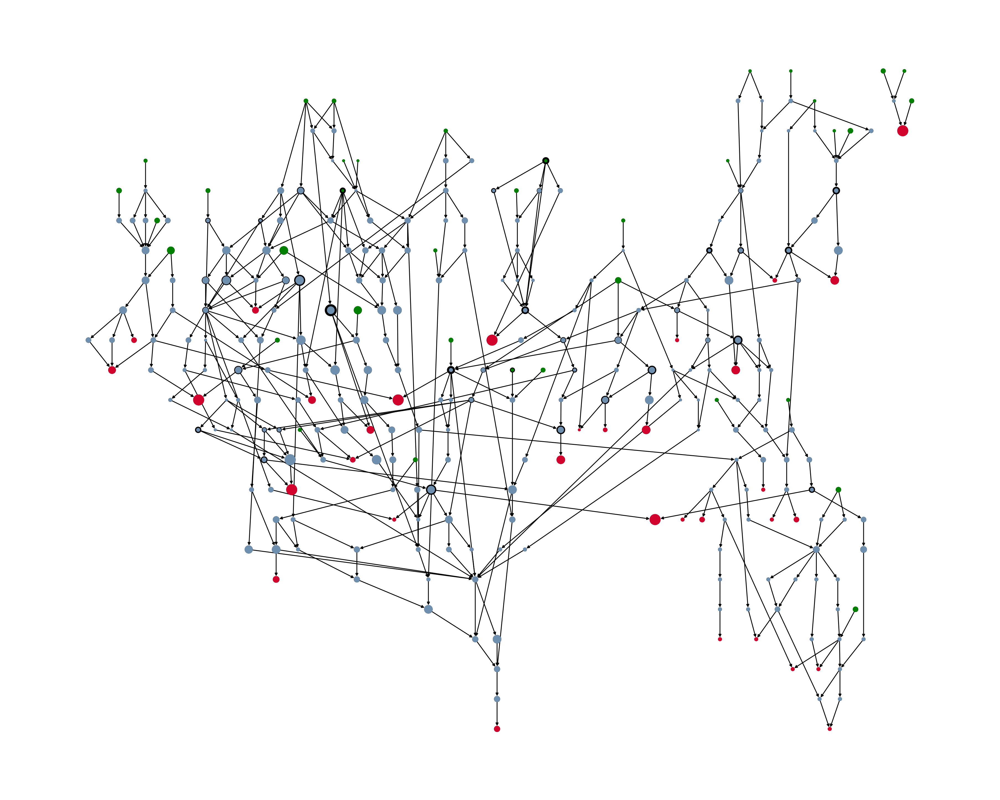

In [5]:
pos_base = nx.nx_agraph.graphviz_layout(graph,prog='dot', args='-Grankdir=TB -Granksep=equally -Gnodesep=equally -Grank=max')

base_figure = graph_base_nodes(pos_base,topic_course_sizes,"Curriculum Graphs/Core Topics.pdf")

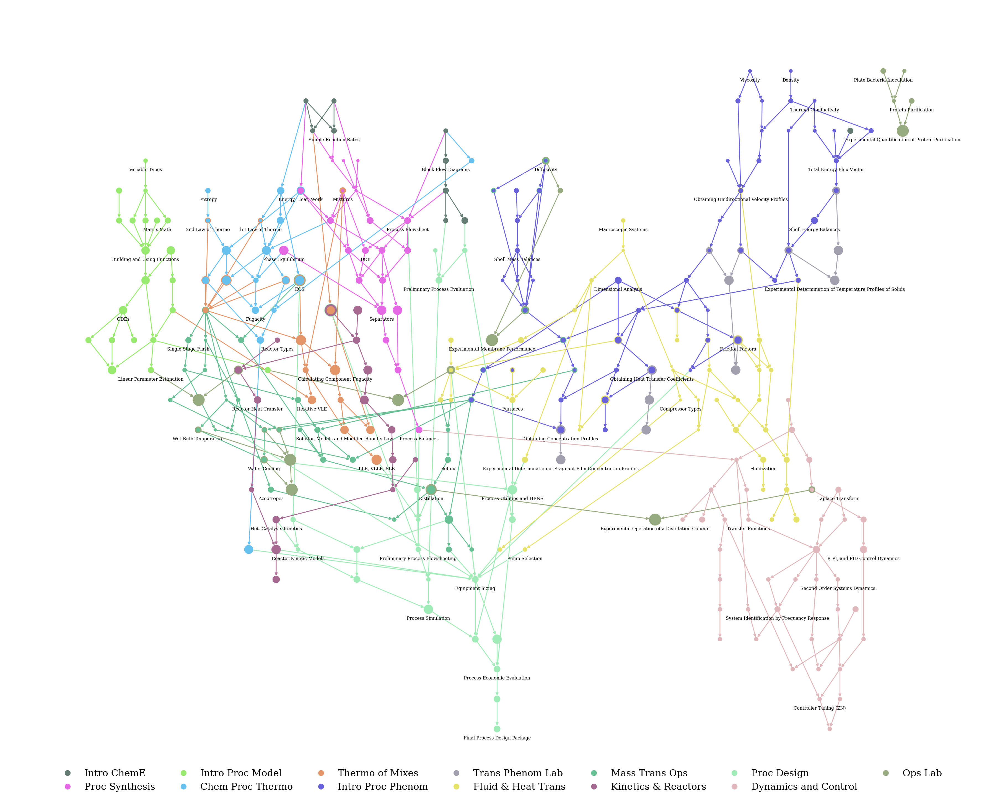

In [7]:
colors = ['#647d73', '#e467e3', '#98ea6e', '#66c1f1', '#e3966a', '#6961da', '#a49fae', '#e6e169', '#66c093', '#a66a93', '#a1ebb8', '#e0b8bb', '#97a97e']
course_colors = dict(zip(courses,colors))

course_names_short = {'CBE 150':'Intro ChemE','CBE 250':'Proc Synthesis','CBE 255':'Intro Proc Model','CBE 310':'Chem Proc Thermo','CBE 311':'Thermo of Mixes','CBE 320':'Intro Proc Phenom','CBE 324':'Trans Phenom Lab','CBE 326':'Fluid & Heat Trans','CBE 426':'Mass Trans Ops','CBE 430':'Kinetics & Reactors','CBE 450':'Proc Design','CBE 470':'Dynamics and Control','CBE 424':'Ops Lab'}

named_fig = graph_module_nodes(pos_base,course_colors,topic_courses,topic_course_sizes,"Curriculum Graphs/Core Topics-Courses.pdf")

label_pos = {}
for node in graph.nodes:
    label_pos[node] = (pos_base[node][0], pos_base[node][1] - 22)
    
nodes_to_label = ['Block Flow Diagrams','Simple Reaction Rates','Heat Tramsfer Intro',
                  'Mixtures','Phase Equilibrium','Phase Equilibrium','Seperators','Process Balances','Energy, Heat, Work','Separators','DOF','Process Flowsheet',
                  'Matrix Math','Variable Types','ODEs','Linear Parameter Estimation','Building and Using Functions',
                  'Derivaitve Relationships','Entropy','1st Law of Thermo','EOS','Fugacity','Unit Entropy Balances''Reversible Carnot Cycle',
                  '2nd Law of Thermo','Solution Models and Modified Raoults Law','Iterative VLE','Calculating Component Fugacity','LLE, VLLE, SLE',
                  'Viscosity','Density','Thermal Conductivity','Diffusivity','Dimensional Analysis','Compressor Types','Macroscopic Systems','Friction Factors','Furnaces','Distillation','Single Stage Flash','Azeotropes','Adsoprtion Equipment','Obtaining Concentration Profiles','Water Cooling','Reflux','Obtaining Unidirectional Velocity Profiles','Total Energy Flux Vector','Shell Mass Balances','Fluidization','Pump Selection','Shell Energy Balances','Obtaining Heat Transfer Coefficients','Wet-Bulb Temperature',
                  'Experimental Determination of Temperature Profiles of Solids','Experimental Determination of Stagnant Film Concentration Profiles',
                  'Experimental Operation of a Distillation Column','Experimental Membrane Performance','Protein Purification','Plate Bacteria Inoculation','Experimental Quantification of Protein Purification',
                  'Reactor Heat Transfer','Het. Catalysts Kinetics','Reactor Types',
                  'Process Utilities and HENS','Preliminary Process Evaluation','Equipment Sizing','Process Simulation','Final Process Design Package','Process Economic Evaluation','Reactor Kinetic Models','Preliminary Process Flowsheeting',
                  'System Identification by Frequency Response','Emperical Process Modeling','Second Order Systems Dynamics','Laplace Transform','Transfer Functions','Controller Tuning (ZN)','P, PI, and PID Control Dynamics']
labels_to_display = {node: node for node in nodes_to_label if node in graph.nodes}
labels = nx.draw_networkx_labels(graph, label_pos,labels=labels_to_display, font_size=16, font_family='serif')

legend_elements = [Line2D([0], [0], marker='o', color=course_color, label=course_names_short[course], lw=0,markerfacecolor=course_color, markersize=20) for course,course_color in course_colors.items()]
font_props = fm.FontProperties(family='serif', size=34)
named_fig.legend(handles=legend_elements, frameon=False, loc = "lower center", ncol=7,prop=font_props)

named_fig.savefig("Curriculum Graphs/Core Topics-Courses.pdf",format="pdf")

Modules form a directed acyclic graph


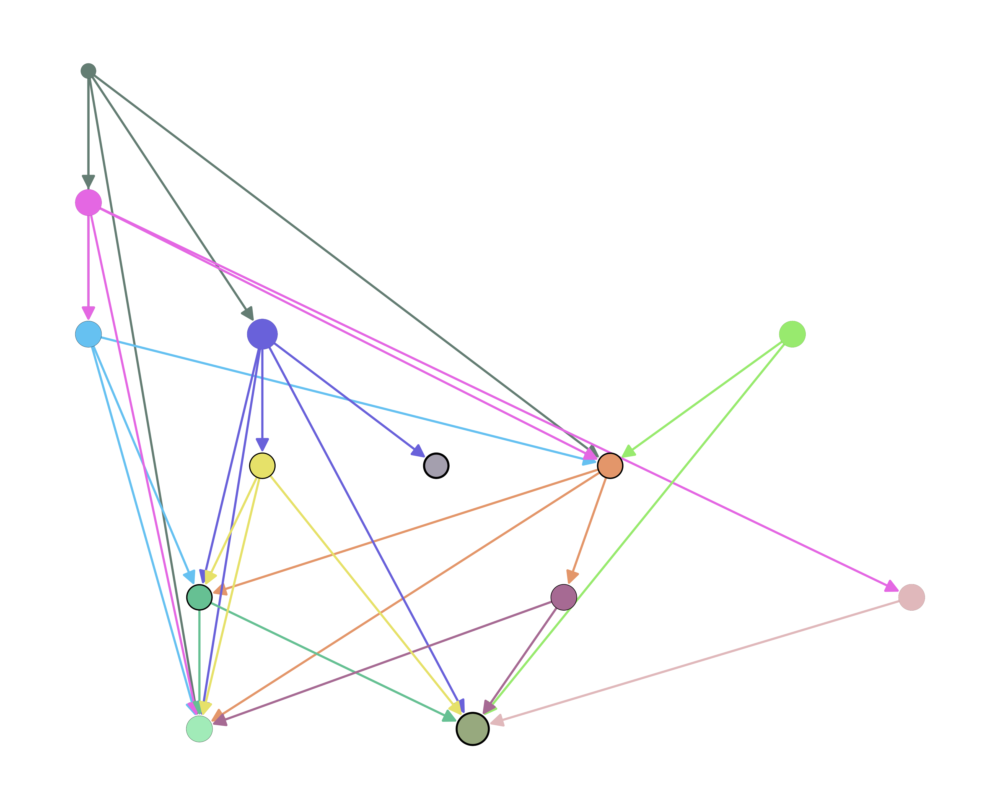

In [8]:
courses_courses_figure = graph_modules(course_topics.values(),course_colors,topic_courses,dict(zip(courses,data["Credits"].tolist())),
                                       "Curriculum Graphs/Core Topics-Course Nodes.pdf")

In [9]:
net = Network(directed = True, notebook=False, width="1920px", height='1080px')
net.from_nx(graph)
for k,i in enumerate(graph.nodes()):
    net.get_node(i)['x'] = pos_base[i][0]
    net.get_node(i)['y'] = -pos_base[i][1]
    net.get_node(i)['physics'] = False
    net.get_node(i)['label'] = str(i)
    successors = list(graph.successors(i))
    if len(successors) == 0:
        net.get_node(i)['color'] = 'red'
    predecessors = list(graph.predecessors(i))
    if len(predecessors) == 0:
        net.get_node(i)['color'] = 'green'
    connections = len(successors) + len(predecessors)
    if connections == 0:
        net.get_node(i)['color'] = 'black'
    net.get_node(i)['title'] = f"Covered In: {topic_courses[i]}\nConnected Componets: {connections}\nPredecessors: {predecessors}\nSuccessors: {successors}"
    net.get_node(i)['size'] = topic_sizes[i] * 50
    if i in reviewed_topics:
        net.get_node(i)['borderWidth'] = (sum(topic_course_sizes[i]) - topic_sizes[i])*50
net.toggle_physics(False)
net.save_graph('Curriculum Graphs/Core Topics.html')

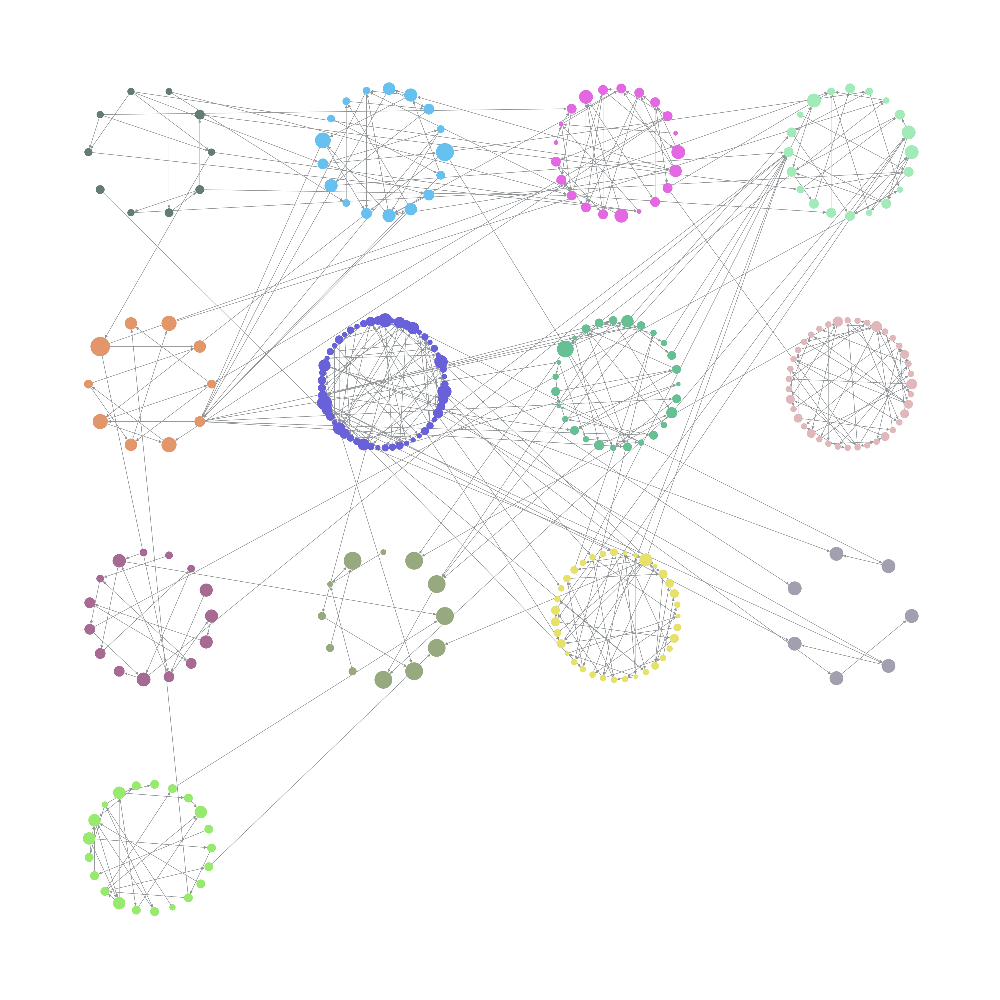

In [10]:
hypergraph = nx.DiGraph()
for k, (i, j) in enumerate(graph.edges()):
    p = topic_courses[i][0]
    q = topic_courses[j][0]
    if p != q:
        hypergraph.add_edge(p, q)

hypergraph_pos = nx.nx_agraph.graphviz_layout(hypergraph, prog='osage')

pos_nodes = dict()
for topics in list(course_topics.values()):
    subgraph = graph.subgraph(topics)
    pos_subgraph = nx.circular_layout(subgraph)
    pos_nodes.update(pos_subgraph)

pos_course = dict()
for topics in list(course_topics.values()):
    for i in topics:
        pos_course[i] = (hypergraph_pos[topic_courses[i][0]][0] + 24*pos_nodes[i][0], 
                       hypergraph_pos[topic_courses[i][0]][1] + 11*pos_nodes[i][1]) 

node_size = [sum(topic_course_sizes[i]) for i in graph.nodes()]
modules_figure_grouped = plt.figure(figsize=(50,50))

nx.draw(graph, pos_course, node_size=[8000*v for v in node_size], node_color=[course_colors[topic_courses[i][0]] for i in graph.nodes()], arrowsize=20, width=2, edge_color='#939799')

modules_figure_grouped.savefig("Curriculum Graphs/Core Topics-Courses Grouped.pdf",format="pdf")

# Analyze Graph

## Ancestors and Descendants

In [11]:
nodes = list(nx.topological_sort(graph))
ancestors = [len(list(nx.ancestors(graph,i))) for i in nodes]
ancestors_dict = dict(zip(nodes,ancestors))
descendants = [len(list(nx.descendants(graph,i))) for i in nodes]
descendants_dict = dict(zip(nodes,descendants))

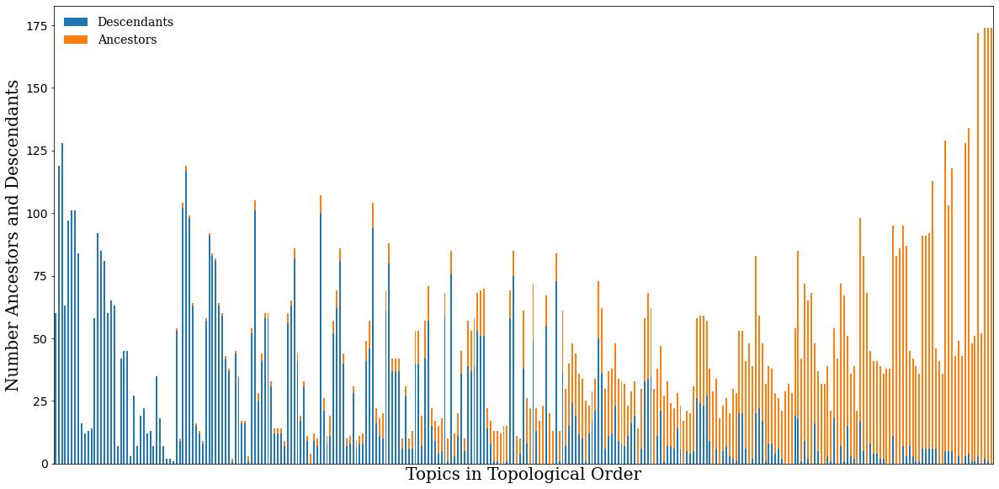

In [12]:
df = pd.DataFrame({
    'Category': nodes,
    'Descendants': descendants,
    'Ancestors': ancestors
})

df.set_index('Category', inplace=True)

ax = df.plot(kind='bar', stacked=True, figsize=(20, 10))
ax.set_xticklabels([])
ax.set_xticks([])

plt.xlabel('Topics in Topological Order', fontsize=20, family='serif')
plt.ylabel('Number Ancestors and Descendants', fontsize=20, family='serif')
ax.tick_params(axis='y', labelsize=14, which='both', labelcolor='black')
plt.legend(loc='best', frameon=False, prop={'family': 'serif', 'size':14})

plt.savefig('Curriculum Graphs/Core Topics-Ancestors and Descendants Bar.pdf')
plt.show()

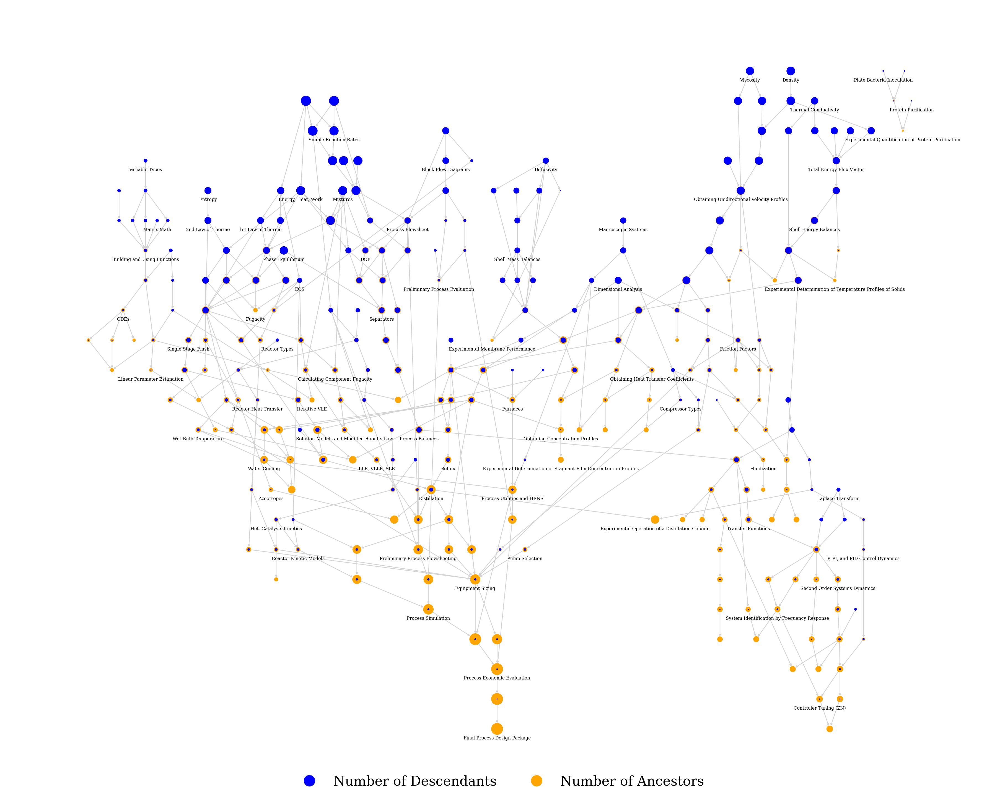

In [13]:
ancestors_figure = plt.figure(figsize=(50,40))

nx.draw(graph,pos_base,node_size=[10*ancestors_dict[i]+10*descendants_dict[i] for i in graph.nodes()],node_color='orange', 
        arrowsize=15, width=2.5, edge_color='#D3D3D3')
nx.draw_networkx_nodes(graph,pos_base,node_size=[10*descendants_dict[i] for i in graph.nodes()],node_color='blue')

label_pos = {}
for node in graph.nodes:
    label_pos[node] = (pos_base[node][0], pos_base[node][1] - 22)
    
nodes_to_label = ['Block Flow Diagrams','Simple Reaction Rates','Heat Tramsfer Intro',
                  'Mixtures','Phase Equilibrium','Phase Equilibrium','Seperators','Process Balances','Energy, Heat, Work','Separators','DOF','Process Flowsheet',
                  'Matrix Math','Variable Types','ODEs','Linear Parameter Estimation','Building and Using Functions',
                  'Derivaitve Relationships','Entropy','1st Law of Thermo','EOS','Fugacity','Unit Entropy Balances''Reversible Carnot Cycle',
                  '2nd Law of Thermo','Solution Models and Modified Raoults Law','Iterative VLE','Calculating Component Fugacity','LLE, VLLE, SLE',
                  'Viscosity','Density','Thermal Conductivity','Diffusivity','Dimensional Analysis','Compressor Types','Macroscopic Systems','Friction Factors','Furnaces','Distillation','Single Stage Flash','Azeotropes','Adsoprtion Equipment','Obtaining Concentration Profiles','Water Cooling','Reflux','Obtaining Unidirectional Velocity Profiles','Total Energy Flux Vector','Shell Mass Balances','Fluidization','Pump Selection','Shell Energy Balances','Obtaining Heat Transfer Coefficients','Wet-Bulb Temperature',
                  'Experimental Determination of Temperature Profiles of Solids','Experimental Determination of Stagnant Film Concentration Profiles',
                  'Experimental Operation of a Distillation Column','Experimental Membrane Performance','Protein Purification','Plate Bacteria Inoculation','Experimental Quantification of Protein Purification',
                  'Reactor Heat Transfer','Het. Catalysts Kinetics','Reactor Types',
                  'Process Utilities and HENS','Preliminary Process Evaluation','Equipment Sizing','Process Simulation','Final Process Design Package','Process Economic Evaluation','Reactor Kinetic Models','Preliminary Process Flowsheeting',
                  'System Identification by Frequency Response','Emperical Process Modeling','Second Order Systems Dynamics','Laplace Transform','Transfer Functions','Controller Tuning (ZN)','P, PI, and PID Control Dynamics']
labels_to_display = {node: node for node in nodes_to_label if node in graph.nodes}
labels = nx.draw_networkx_labels(graph, label_pos,labels=labels_to_display, font_size=16, font_family='serif')

legend_elements = [Line2D([0], [0], marker='o', color='blue', label='Number of Descendants', lw=0,markerfacecolor='blue', markersize=40),
                  Line2D([0], [0], marker='o', color='orange', label='Number of Ancestors', lw=0,markerfacecolor='orange', markersize=40)]
font_props = fm.FontProperties(family='serif', size=48)
ancestors_figure.legend(handles=legend_elements, frameon=False, loc = "lower center", ncol=2,prop=font_props)
ancestors_figure.savefig("Curriculum Graphs/Core Topics-Ancestors and Descendants.pdf",format="pdf")

plt.show()

## Emphasis Factor

Mean:   1.998
Median: 0.909
Max:    41.2
Min:    0.092
Counts
Below 0.3333: 39
0.3333 - 3.0: 194
Above 3.0: 54


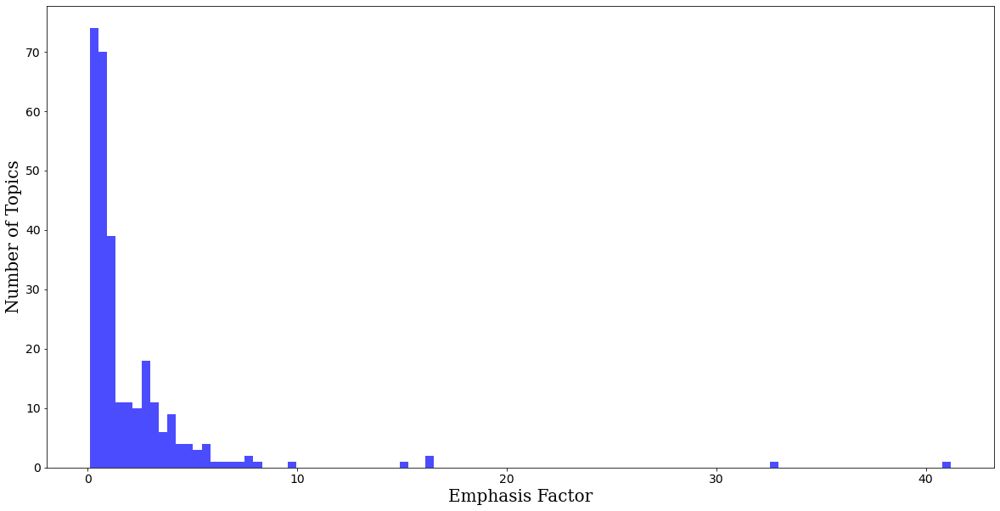

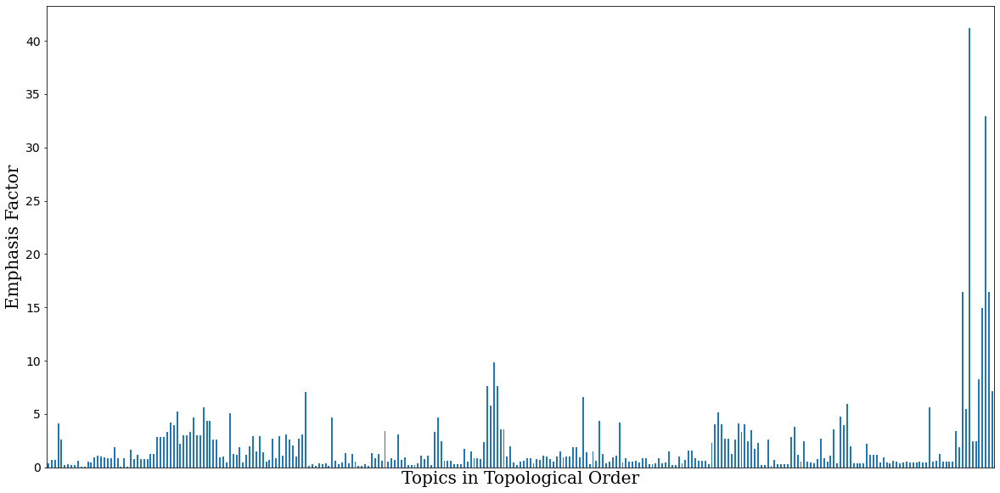

In [14]:
nodes = list(nx.topological_sort(graph))
avg_size = np.mean([sum(topic_course_sizes[i]) for i in nodes])
avg_ancestors = np.mean([len(nx.ancestors(graph,i)) for i in nodes])
avg_descendants = np.mean([len(nx.descendants(graph,i)) for i in nodes])

emphasis_factor = {}

for i in graph.nodes():
    size = sum(topic_course_sizes[i])
    ancestors = len(nx.ancestors(graph,i))
    descendants = len(nx.descendants(graph,i))
    emphasis_factor[i] = (size / avg_size) / ((ancestors+descendants)/(avg_ancestors+avg_descendants)) 

print('Mean:  ',round(np.mean([emphasis_factor[i] for i in nodes]),3))
print('Median:',round(np.median([emphasis_factor[i] for i in nodes]),3))
print('Max:   ',round(max([emphasis_factor[i] for i in nodes]),3))
print('Min:   ',round(min([emphasis_factor[i] for i in nodes]),3))

under = 0
over = 0
good = 0
for i in nodes:
    if emphasis_factor[i] < 0.3333:
        under += 1
    elif emphasis_factor[i] > 3:
        over += 1
    else:
        good += 1

print('Counts')
print('Below 0.3333:',under)
print('0.3333 - 3.0:',good)
print('Above 3.0:',over)

plt.figure(figsize=(20,10))
plt.hist(list(emphasis_factor.values()), bins=100, alpha=0.7, color='blue')
plt.xlabel('Emphasis Factor', fontsize=20, family='serif')
plt.ylabel('Number of Topics', fontsize=20, family='serif')
plt.tick_params(axis='x', which='major', labelsize=14)
plt.tick_params(axis='y', which='major', labelsize=14)

plt.savefig('Curriculum Graphs/Core Topics-Emphasis Factor Histogram.pdf')
plt.show()

df = pd.DataFrame({
    'Category': nodes,
    'Emphasis Factor': list(emphasis_factor.values()),
})

df.set_index('Category', inplace=True)

ax = df.plot(kind='bar', figsize=(20, 10))
ax.set_xticklabels([])
ax.set_xticks([])
ax.legend().set_visible(False)

plt.xlabel('Topics in Topological Order', fontsize=20, family='serif')
plt.ylabel('Emphasis Factor', fontsize=20, family='serif')
ax.tick_params(axis='y', labelsize=14, which='both', labelcolor='black')

plt.savefig('Curriculum Graphs/Core Topics-Emphasis Factor Bar.pdf')
plt.show()

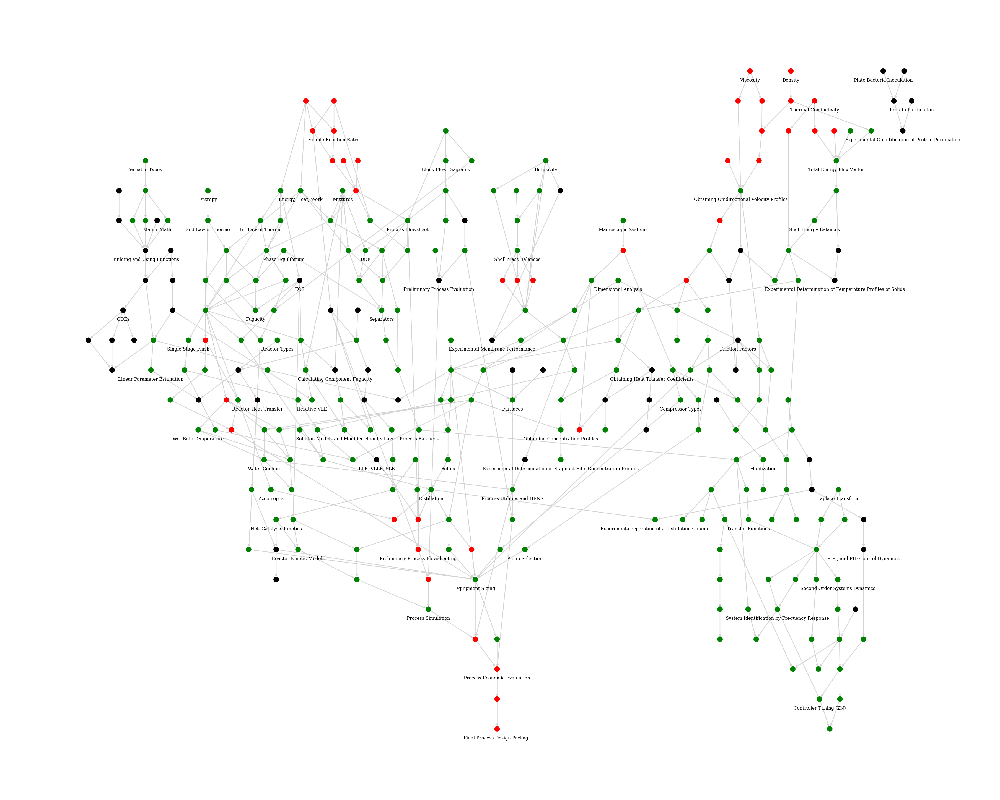

In [15]:
node_colors = []

for i in graph.nodes():
    if emphasis_factor[i] > 3:
        node_colors.append('black')
    elif emphasis_factor[i] < 1/3:
        node_colors.append('red')
    else:
        node_colors.append('green')

plt.figure(figsize=(50,40))

nx.draw(graph, pos_base, node_size=350, node_color=[color for color in node_colors], 
        arrowsize=15, width=2.5, edge_color='#D3D3D3')

label_pos = {}
for node in graph.nodes:
    label_pos[node] = (pos_base[node][0], pos_base[node][1] - 22)
    
nodes_to_label = ['Block Flow Diagrams','Simple Reaction Rates','Heat Tramsfer Intro',
                  'Mixtures','Phase Equilibrium','Phase Equilibrium','Seperators','Process Balances','Energy, Heat, Work','Separators','DOF','Process Flowsheet',
                  'Matrix Math','Variable Types','ODEs','Linear Parameter Estimation','Building and Using Functions',
                  'Derivaitve Relationships','Entropy','1st Law of Thermo','EOS','Fugacity','Unit Entropy Balances''Reversible Carnot Cycle',
                  '2nd Law of Thermo','Solution Models and Modified Raoults Law','Iterative VLE','Calculating Component Fugacity','LLE, VLLE, SLE',
                  'Viscosity','Density','Thermal Conductivity','Diffusivity','Dimensional Analysis','Compressor Types','Macroscopic Systems','Friction Factors','Furnaces','Distillation','Single Stage Flash','Azeotropes','Adsoprtion Equipment','Obtaining Concentration Profiles','Water Cooling','Reflux','Obtaining Unidirectional Velocity Profiles','Total Energy Flux Vector','Shell Mass Balances','Fluidization','Pump Selection','Shell Energy Balances','Obtaining Heat Transfer Coefficients','Wet-Bulb Temperature',
                  'Experimental Determination of Temperature Profiles of Solids','Experimental Determination of Stagnant Film Concentration Profiles',
                  'Experimental Operation of a Distillation Column','Experimental Membrane Performance','Protein Purification','Plate Bacteria Inoculation','Experimental Quantification of Protein Purification',
                  'Reactor Heat Transfer','Het. Catalysts Kinetics','Reactor Types',
                  'Process Utilities and HENS','Preliminary Process Evaluation','Equipment Sizing','Process Simulation','Final Process Design Package','Process Economic Evaluation','Reactor Kinetic Models','Preliminary Process Flowsheeting',
                  'System Identification by Frequency Response','Emperical Process Modeling','Second Order Systems Dynamics','Laplace Transform','Transfer Functions','Controller Tuning (ZN)','P, PI, and PID Control Dynamics']
labels_to_display = {node: node for node in nodes_to_label if node in graph.nodes}
labels = nx.draw_networkx_labels(graph, label_pos,labels=labels_to_display, font_size=16, font_family='serif')

plt.savefig('Curriculum Graphs/Core Topics-Emphasis Factor.pdf')

# Topic Grouping

## Modularity

In [16]:
# n_m = 13
# max_size = 4.1
# min_size = 2.9
# time_limit = 60*60*12 
# (modules,modularity,module_reviews) = make_modules(n_m, max_size, min_size,time_limit)
# 10 solutions found
# 6.25% optimilaity gap 
# 0.41687 objective (no new best objective found after 2.1 hours)
# 0.44293 best bound
modules = [['Processes', 'Block Flow Diagrams', 'PFD Basics', 'Process Costs Basics', 'Safety and Ethics Basics', 'Aspen RADFRAC', 'Trayed Columns Operating Curves', 'Distillation', 'Enhanced Distillation', 'Solving Multicomponent Distillation', 'Tray Efficiency', 'Azeotropes', 'Identification of Separation Sequences', 'Preliminary Process Flowsheeting', 'Preliminary Process Selection', 'Process Simulation', 'Process Efficiency Measures', 'Preliminary Process Evaluation', 'Preliminary Process Operating Costs', 'Separation Models', 'Modeling Reactor-Separator Systems', 'Thermo Models', 'Reactor Kinetic Models'], ['Convective Mass Flux Vector', 'Total Mass Flux Vector', 'Shell Mass Balances', 'Gas Absorption', 'Solid Dissolution', 'Porous Diffusions', 'Obtaining Unidirectional Concentration Profiles', 'Diffusivity', 'Diffusive Mass Flux Vector', 'Obtaining Diffusivity Data', 'Fluids Mixing', 'Sensitivity and Optimization', 'Final Process Design Package', 'Experimental Operation of a Distillation Column', 'Plate Bacteria Inoculation', 'Bioreactor Inoculation', 'Experimental Quantification of Protein Purification', 'Enzymatic Activity Assay', 'Experimental Membrane Performance', 'Protein Purification', 'Permeability'], ['Macroscopic Balances for Multicomponent Systems', 'Obtaining Concentration Profiles', 'Binary Mixture Molecular Fluxes', 'Obtaining Mass Transfer Coefficients', 'Experimental Determination of Heat Transfer in Circular Pipes', 'Experimental Heating of Liquids in Tank Storage', 'Absorption and Stripping', 'Humidification', 'Dehumidification', 'Rate Based Methods for Packed Columns', 'Single Stage Flash', 'Humidity', 'Countercurrent Contacting', 'Trayed Columns', 'Packed Columns', 'Wet-Bulb Temperature', 'Water Cooling', 'Experimental Humidification and Dehumidification', 'Experimental Water Cooling'], ['Chemical Process Definition', 'Process Variables', 'Process Control Components', 'Formulating Single Input Single Output Process Models', 'Control System Configuration', 'Feedback Control Strategy', 'P, PI, and PID Control Dynamics', 'Closed-Loop Transient Response', 'Closed-Loop Stability', 'Choosing Controller Type', 'Controller Tuning (ZN)', 'Design of Complex Control Structures', 'Laplace Transform', 'Solving ODEs with Laplace Transforms', 'Forcing Functions', 'First Order Systems Dynamics', 'Time Delay Systems Dynamics', 'System Identification by Frequency Response', 'Inverse Response Systems Dynamics', 'Model Types', 'Theoretical Process Modeling', 'Formulating Multivariable Process Models', 'Transfer Functions', 'Second Order Systems Dynamics', 'Nonlinear Systems', 'Higher Order Systems Dynamics', 'Stability of Linear Systems', 'Empirical Process Modeling', 'Solution Approaches for Nonlinear Systems', 'Stability of Nonlinear Systems', 'Stability of Multivariable Systems', 'Stability', 'Open Loop Dynamic Analysis', 'Intro to Optimization', 'Model Predictive Control', 'Closed-Loop Dynamic Analysis'], ['Compressor Types', 'Compressor Performance', 'Macroscopic Systems', 'Unit Operation Definition', 'Flow Systems', 'Heat Exchange Equipment', 'Pump Types', 'Pump Performance', 'Pump Selection', 'Fins', 'Estimating Heat Transfer in Exchangers', 'Mean Temperature Differences', 'Heat Exchange Networks', 'Heat Exchanger Contacting Patterns', 'Condensing', 'Boiling', 'Furnaces', 'Forced and Natural Convection', 'Matrix Formulations for Radiation Heat Transfer', 'Column Hydraulics', 'Condensers and Reboilers', 'Reflux', 'Design Specification Package', 'Process Economic Evaluation', 'Process Utilities and HENS', 'Operating Cost Estimation', 'Equipment Sizing', 'Capital Cost Estimation'], ['Chemical Equilibrium', 'Reactive Process Material Balances', 'Recycle and Purge', 'Process Balances', 'Variable Types', 'Indexing', 'For Loops', 'Plotting', 'Read/Write Data', 'Matrix Math', 'Building and Using Functions', 'Logic', 'If Statement', 'Reversible Carnot Cycle', 'Irreversible Carnot Cycle', 'General Power and Refrigeration Cycles', 'Cyclic Processes', 'Experimental Determination of Stagnant Film Concentration Profiles', 'Interaction Analysis', 'Loop Pairing', 'Relative Gain Analysis'], ['Solving Linear Systems of Equations', 'ODEs', 'Parameter Estimation', 'Numerical Solutions to ODEs', 'Symbolic Solutions to ODEs', 'Integrate and Interpolate', 'ODE Parameter Estimation', 'Linear Systems of Equations', 'Nonlinear Systems of Equations', 'Solving Nonlinear Systems of Equations', 'Linear Parameter Estimation', 'Nonlinear Parameter Estimation', 'Experimental Determination of Heat Transfer in Exchangers', 'Experimental Determination of Irreversible Reaction Kinetics'], ['Heat Transfer Intro', 'Density', 'Convective Momentum Flux Tensor', 'Total Momentum Flux Tensor', 'Convective Energy Flux Vector', 'Shell Momentum Balances', 'Obtaining Unidirectional Velocity Profiles', 'Equation of Motion', 'Obtaining Turbulent Velocity Profiles', 'Equations of Change for Mechanical Energy', 'Viscosity', 'Molecular Momentum Flux Tensor', 'Obtaining Viscosity Data', 'Laminar vs Turbulent Flow', 'Obtaining Turbulent Temperature Profiles', 'Thermal Conductivity', 'Conductive Heat Flux Vector', 'Obtaining Thermal Conductivity Data', 'Total Energy Flux Vector', 'Overall Heat Transfer Coefficients', 'Shell Energy Balances', 'Obtaining Unidirectional Temperature Profiles with Flat Velocity Profiles', 'Work Flux Vector', 'Experimental Determination of Turbulent Velocity Profiles', 'Experimental Determination of Friction Factors', 'Experimental Determination of Thermal Conductivity of Solids', 'Experimental Determination of Temperature Profiles of Solids', 'Fluidization', 'Fluidization Applications'], ['Isothermal Equations of Change', 'Macroscopic Momentum Balance', 'Dimensional Analysis for Isothermal Systems', 'Nonisothermal Equations of Change', 'Macroscopic Mechanical Energy Balance', 'Estimating Viscous Losses', 'Dimensional Analysis', 'Dimensional Analysis for Nonisothermal Systems', 'Dimensional Analysis For Flowing Mixtures', 'Friction Factors', 'Energy Equation', 'Macroscopic Energy Balance for Nonisothermal Systems', 'Equations of Change For Binary Mixtures from Conservation Laws', 'Obtaining Temperature Profiles for Flat Velocity Profiles', 'Obtaining Temperature Profiles for Non-flat Velocity Profiles', 'Obtaining Heat Transfer Coefficients', 'Incompressible Flow in Conduits', 'Bernoulli Equation', 'Incompressible Flow Through Valves and Fittings', 'Compressible Flow', 'Boundary Layers', 'Skin Friction', 'Form Drag', 'Flow Past Particles', 'Flow Through Packed Beds', 'Particle Properties'], ['Material Properties (T,P,U)', 'Ideal Gasses and Real Fluids', '1st Law of Thermo', 'EOS', 'Unit Energy Balances', 'General Energy Balances', 'Derivative Relationships', 'Phase Equilibrium Conditions for Pure Components', 'Unit Entropy Balances', 'General Entropy Balances', 'Entropy', '2nd Law of Thermo', 'Fugacity', 'Phase Equilibrium Conditions', 'Predictive Modeling', 'Adsorption', 'Adsorption Equipment', 'Ion Exchange', 'Percolation', 'Ion Exchange Cycle'], ['Energy Transport by Radiation', 'Irreversible Empirical Reaction Kinetics', 'Irreversible Mechanistic Reaction Kinetics', 'Irreversible Ideal Isothermal Reactor Sizing', 'Reversible Reaction Kinetics', 'Multiple Reaction Systems', 'Catalytic Reactions', 'Het. Catalyst Mass Transfer', 'Het. Catalysts Kinetics', 'Het. Catalytic Reactor Design', 'Non-Ideal Flow in Reactors', 'Reaction Rate Constants and Orders', 'Reactor Types', 'Reactor Heat Transfer', 'Reactor Thermal Effects', 'Physical Properties of Het. Catalysts'], ['Departure Functions and Fugacity', 'Ideal Solutions and Raoults Law', 'Calculating Component Fugacity', 'Iterative VLE', 'Solution Models and Modified Raoults Law', 'Activity Models', 'Multiphase Reactions', 'LLE, VLLE, SLE', 'Reaction Equilibrium Conditions', 'Isentropic Flow Through Nozzles', 'Isothermal and Adiabatic Friction Flow', 'Measuring Fluid Flow'], ['Mass Balances', 'Simple Reaction Rates', 'Simple Reaction Equilibrium', 'Intro to Thermo', 'Simple Reactor', 'Process Units', 'Mixtures', 'SS Unit Energy Balances', 'DOF', 'Time Dependent Process Variables', 'SS Unit Material Balances', 'SS Multi-Unit Energy Balances', 'SS Multi-Unit Material Balances', 'SS General Material Balances', 'SS General Energy Balances', 'Simple Splitter/Separator', 'Process Flowsheet', 'Mixer', 'Separators', 'Phase Equilibrium', 'Energy, Heat, Work', 'Constructing PFDs']]
module_reviews = [['Distillation', 'Experimental Operation of a Distillation Column'], ['Obtaining Unidirectional Concentration Profiles', 'Equations of Change For Binary Mixtures from Conservation Laws'], ['Obtaining Concentration Profiles', 'Experimental Determination of Stagnant Film Concentration Profiles'], ['Obtaining Mass Transfer Coefficients', 'Aspen RADFRAC'], ['Control System Configuration', 'Experimental Operation of a Distillation Column'], ['Estimating Heat Transfer in Exchangers', 'Experimental Determination of Heat Transfer in Exchangers'], ['Obtaining Unidirectional Velocity Profiles', 'Boundary Layers'], ['Dimensional Analysis for Isothermal Systems', 'Fluids Mixing'], ['Dimensional Analysis for Nonisothermal Systems', 'Estimating Heat Transfer in Exchangers'], ['Dimensional Analysis For Flowing Mixtures', 'Obtaining Mass Transfer Coefficients'], ['Friction Factors', 'Experimental Determination of Friction Factors'], ['Equations of Change For Binary Mixtures from Conservation Laws', 'Binary Mixture Molecular Fluxes'], ['Obtaining Temperature Profiles for Flat Velocity Profiles', 'Fins'], ['Obtaining Heat Transfer Coefficients', 'Experimental Determination of Heat Transfer in Circular Pipes'], ['EOS', 'Departure Functions and Fugacity'], ['Phase Equilibrium Conditions', 'Single Stage Flash'], ['Phase Equilibrium Conditions', 'Humidity'], ['Energy Transport by Radiation', 'Furnaces'], ['Irreversible Ideal Isothermal Reactor Sizing', 'Experimental Determination of Irreversible Reaction Kinetics'], ['Reaction Equilibrium Conditions', 'Irreversible Empirical Reaction Kinetics'], ['Reaction Equilibrium Conditions', 'Preliminary Process Flowsheeting'], ['Mixtures', 'Ideal Solutions and Raoults Law'], ['Mixtures', 'Calculating Component Fugacity'], ['Energy, Heat, Work', 'Unit Energy Balances'], ['Energy, Heat, Work', 'Unit Entropy Balances']]

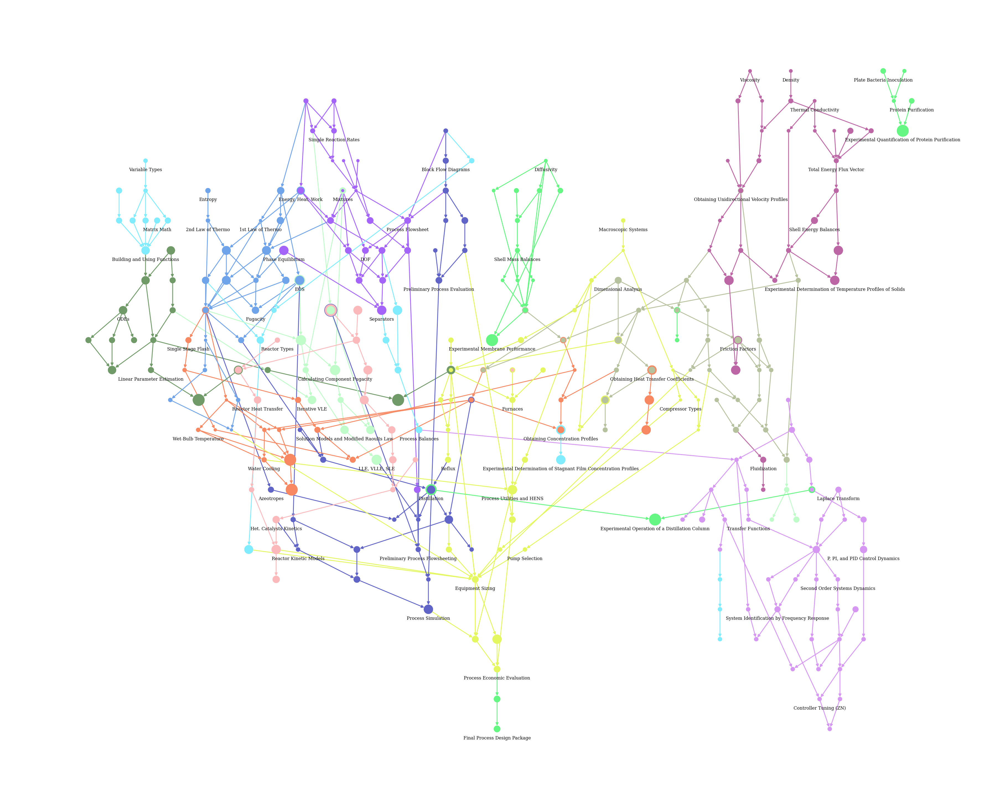

In [17]:
(topic_modules, topic_module_sizes, module_size, module_review_sizes, module_reviewed_topics) = process_modules(modules,module_reviews)

n_modules = len(modules)
colors = ['#6064c7','#66f683','#f88862','#d697f3','#e4f660','#80ecfd','#709b68','#bc66a5','#b6c19e','#70a4ea','#fcb9bb','#c0fbca','#a464fa']
module_colors = dict(zip(np.arange(0,n_modules,1),colors))

module_figure = graph_module_nodes(pos_base,module_colors,topic_modules,topic_module_sizes,"Curriculum Graphs/Core Topics-Modules.pdf")

label_pos = {}
for node in graph.nodes:
    label_pos[node] = (pos_base[node][0], pos_base[node][1] - 22)
    
nodes_to_label = ['Block Flow Diagrams','Simple Reaction Rates','Heat Tramsfer Intro',
                  'Mixtures','Phase Equilibrium','Phase Equilibrium','Seperators','Process Balances','Energy, Heat, Work','Separators','DOF','Process Flowsheet',
                  'Matrix Math','Variable Types','ODEs','Linear Parameter Estimation','Building and Using Functions',
                  'Derivaitve Relationships','Entropy','1st Law of Thermo','EOS','Fugacity','Unit Entropy Balances''Reversible Carnot Cycle',
                  '2nd Law of Thermo','Solution Models and Modified Raoults Law','Iterative VLE','Calculating Component Fugacity','LLE, VLLE, SLE',
                  'Viscosity','Density','Thermal Conductivity','Diffusivity','Dimensional Analysis','Compressor Types','Macroscopic Systems','Friction Factors','Furnaces','Distillation','Single Stage Flash','Azeotropes','Adsoprtion Equipment','Obtaining Concentration Profiles','Water Cooling','Reflux','Obtaining Unidirectional Velocity Profiles','Total Energy Flux Vector','Shell Mass Balances','Fluidization','Pump Selection','Shell Energy Balances','Obtaining Heat Transfer Coefficients','Wet-Bulb Temperature',
                  'Experimental Determination of Temperature Profiles of Solids','Experimental Determination of Stagnant Film Concentration Profiles',
                  'Experimental Operation of a Distillation Column','Experimental Membrane Performance','Protein Purification','Plate Bacteria Inoculation','Experimental Quantification of Protein Purification',
                  'Reactor Heat Transfer','Het. Catalysts Kinetics','Reactor Types',
                  'Process Utilities and HENS','Preliminary Process Evaluation','Equipment Sizing','Process Simulation','Final Process Design Package','Process Economic Evaluation','Reactor Kinetic Models','Preliminary Process Flowsheeting',
                  'System Identification by Frequency Response','Emperical Process Modeling','Second Order Systems Dynamics','Laplace Transform','Transfer Functions','Controller Tuning (ZN)','P, PI, and PID Control Dynamics']
labels_to_display = {node: node for node in nodes_to_label if node in graph.nodes}
labels = nx.draw_networkx_labels(graph, label_pos,labels=labels_to_display, font_size=16, font_family='serif')

module_figure.savefig("Curriculum Graphs/Core Topics-Modules.pdf",format="pdf")

plt.show()

In [18]:
pos_module = module_position(modules,topic_modules)

for i in graph.nodes():
    net.get_node(i)['x'] = pos_module[i][0]
    net.get_node(i)['y'] = -pos_module[i][1]
    net.get_node(i)['borderWidth'] = 0
    net.get_node(i)['color'] = module_colors[topic_modules[i][0]]
    if i in reviewed_topics:
        net.get_node(i)['borderWidth'] = (sum(topic_module_sizes[i]) - topic_sizes[i])*50

net.save_graph('Curriculum Graphs/Core Topics-Modules.html')

Modules do not form a directed acyclic graph


Modules do not form a directed acyclic graph


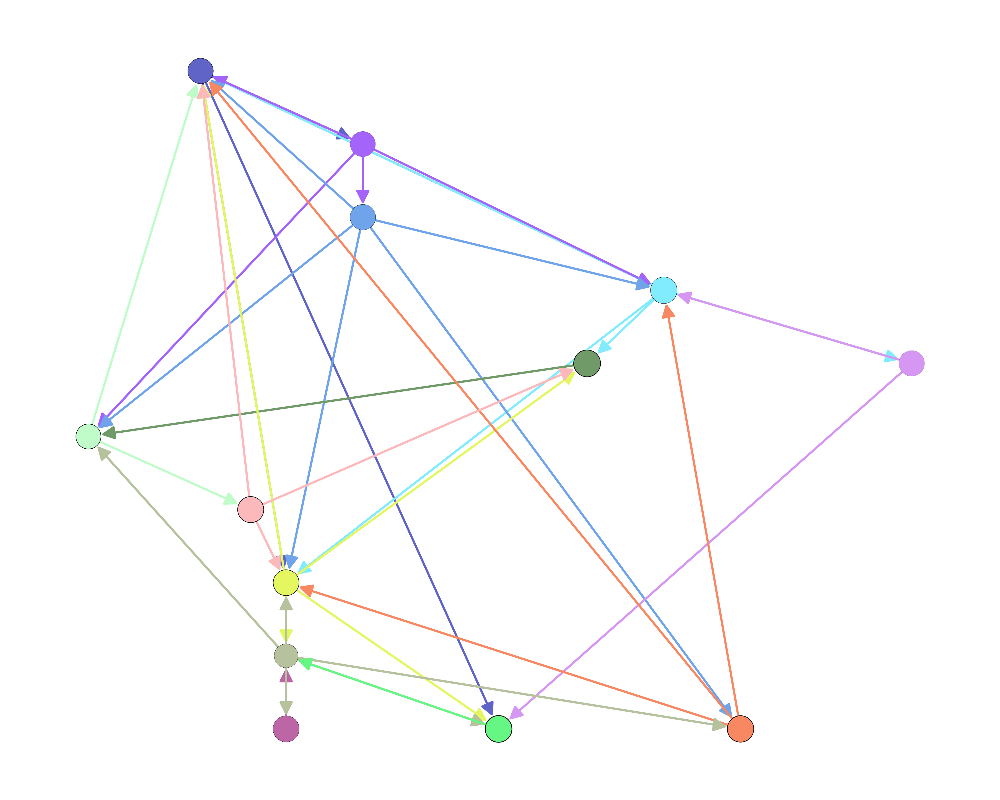

In [19]:
modules_modules_figure = graph_modules(modules,module_colors,topic_modules,dict(zip(np.arange(0,len(modules),1),module_size)),
                                       "Curriculum Graphs/Core Topics-Module Nodes.pdf")

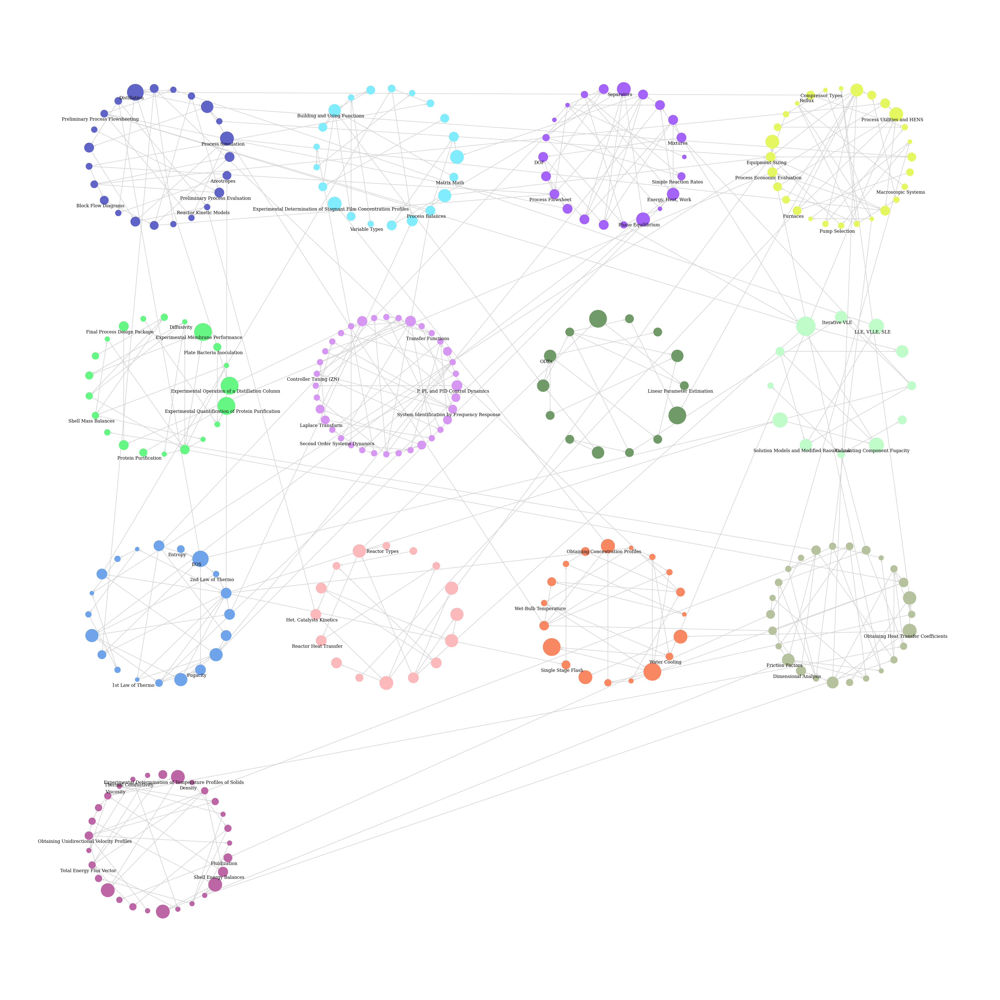

In [20]:
hypergraph = nx.DiGraph()
for k, (i, j) in enumerate(graph.edges()):
    p = topic_modules[i][0]
    q = topic_modules[j][0]
    if p != q:
        hypergraph.add_edge(p, q)

hypergraph_pos = nx.nx_agraph.graphviz_layout(hypergraph, prog='osage')

pos_nodes = dict()
for topics in modules:
    subgraph = graph.subgraph(topics)
    pos_subgraph = nx.circular_layout(subgraph)
    pos_nodes.update(pos_subgraph)

pos_module = dict()
for topics in modules:
    for i in topics:
        pos_module[i] = (hypergraph_pos[topic_modules[i][0]][0] + 18*pos_nodes[i][0], 
                       hypergraph_pos[topic_modules[i][0]][1] + 12*pos_nodes[i][1]) 

node_size = [sum(topic_module_sizes[i]) for i in graph.nodes()]
modules_figure_grouped = plt.figure(figsize=(50,50))

nx.draw(graph, pos_module, node_size=[8000*v for v in node_size], node_color=[module_colors[topic_modules[i][0]] for i in graph.nodes()], arrowsize=10, width=2, edge_color='#D3D3D3')

label_pos = {}
for node in graph.nodes:
    label_pos[node] = (pos_module[node][0]-1, pos_module[node][1]-1)
    
nodes_to_label = ['Block Flow Diagrams','Simple Reaction Rates','Heat Tramsfer Intro',
                  'Mixtures','Phase Equilibrium','Phase Equilibrium','Seperators','Process Balances','Energy, Heat, Work','Separators','DOF','Process Flowsheet',
                  'Matrix Math','Variable Types','ODEs','Linear Parameter Estimation','Building and Using Functions',
                  'Derivaitve Relationships','Entropy','1st Law of Thermo','EOS','Fugacity','Unit Entropy Balances''Reversible Carnot Cycle',
                  '2nd Law of Thermo','Solution Models and Modified Raoults Law','Iterative VLE','Calculating Component Fugacity','LLE, VLLE, SLE',
                  'Viscosity','Density','Thermal Conductivity','Diffusivity','Dimensional Analysis','Compressor Types','Macroscopic Systems','Friction Factors','Furnaces','Distillation','Single Stage Flash','Azeotropes','Adsoprtion Equipment','Obtaining Concentration Profiles','Water Cooling','Reflux','Obtaining Unidirectional Velocity Profiles','Total Energy Flux Vector','Shell Mass Balances','Fluidization','Pump Selection','Shell Energy Balances','Obtaining Heat Transfer Coefficients','Wet-Bulb Temperature',
                  'Experimental Determination of Temperature Profiles of Solids','Experimental Determination of Stagnant Film Concentration Profiles',
                  'Experimental Operation of a Distillation Column','Experimental Membrane Performance','Protein Purification','Plate Bacteria Inoculation','Experimental Quantification of Protein Purification',
                  'Reactor Heat Transfer','Het. Catalysts Kinetics','Reactor Types',
                  'Process Utilities and HENS','Preliminary Process Evaluation','Equipment Sizing','Process Simulation','Final Process Design Package','Process Economic Evaluation','Reactor Kinetic Models','Preliminary Process Flowsheeting',
                  'System Identification by Frequency Response','Emperical Process Modeling','Second Order Systems Dynamics','Laplace Transform','Transfer Functions','Controller Tuning (ZN)','P, PI, and PID Control Dynamics']
labels_to_display = {node: node for node in nodes_to_label if node in graph.nodes}
labels = nx.draw_networkx_labels(graph, label_pos,labels=labels_to_display, font_size=16, font_family='serif')

modules_figure_grouped.savefig("Curriculum Graphs/Core Topics-Modules Grouped.pdf",format="pdf")

## Sequenced Modularity

### Without Initialization

In [21]:
# n_m = 13
# max_size = 6
# min_size = 1
# time_limit = 60*60*24
# (sequenced_modules,sequenced_modularity,sequenced_module_reviews) = make_sequenced_modules(n_m, max_size, min_size, time_limit)
# no solutions found
# 0.4990 best bound

### With Initialization

In [22]:
# n_m = 13
# max_size = 6
# min_size = 1
# time_limit = 60*60*6
# (sequenced_modules,sequenced_modularity,sequenced_module_reviews) = make_sequenced_modules_initial(n_m, max_size, min_size, time_limit)
# 9 solutions found
# 15.23% optimilaity gap 
# 0.43176 objective 
# 0.49752 best bound
# sequenced_modules = [['Processes', 'Block Flow Diagrams', 'PFD Basics', 'Process Costs Basics', 'Safety and Ethics Basics', 'Cyclic Processes', 'Reaction Rate Constants and Orders', 'Process Efficiency Measures', 'Preliminary Process Evaluation', 'Preliminary Process Operating Costs'], ['Mass Balances', 'Simple Reaction Rates', 'Simple Reaction Equilibrium', 'Intro to Thermo', 'Simple Reactor', 'Process Units', 'Mixtures', 'SS Unit Energy Balances', 'DOF', 'Time Dependent Process Variables', 'SS Unit Material Balances', 'SS Multi-Unit Energy Balances', 'SS Multi-Unit Material Balances', 'SS General Material Balances', 'Chemical Equilibrium', 'SS General Energy Balances', 'Simple Splitter/Separator', 'Process Flowsheet', 'Mixer', 'Separators', 'Reactive Process Material Balances', 'Phase Equilibrium', 'Recycle and Purge', 'Process Balances', 'Energy, Heat, Work'], ['Variable Types', 'Indexing', 'For Loops', 'Plotting', 'Read/Write Data', 'Matrix Math', 'Building and Using Functions', 'Solving Linear Systems of Equations', 'ODEs', 'Parameter Estimation', 'Numerical Solutions to ODEs', 'Symbolic Solutions to ODEs', 'Integrate and Interpolate', 'ODE Parameter Estimation', 'Logic', 'If Statement', 'Linear Systems of Equations', 'Nonlinear Systems of Equations', 'Solving Nonlinear Systems of Equations', 'Linear Parameter Estimation', 'Nonlinear Parameter Estimation', 'Experimental Determination of Heat Transfer in Exchangers'], ['Material Properties (T,P,U)', 'Ideal Gasses and Real Fluids', '1st Law of Thermo', 'EOS', 'Unit Energy Balances', 'General Energy Balances', 'Derivative Relationships', 'Phase Equilibrium Conditions for Pure Components', 'Reversible Carnot Cycle', 'Irreversible Carnot Cycle', 'General Power and Refrigeration Cycles', 'Unit Entropy Balances', 'General Entropy Balances', 'Entropy', '2nd Law of Thermo', 'Fugacity', 'Phase Equilibrium Conditions', 'Predictive Modeling', 'Adsorption', 'Adsorption Equipment', 'Ion Exchange', 'Percolation', 'Ion Exchange Cycle'], ['Departure Functions and Fugacity', 'Ideal Solutions and Raoults Law', 'Calculating Component Fugacity', 'Iterative VLE', 'Solution Models and Modified Raoults Law', 'Activity Models', 'Multiphase Reactions', 'Reaction Equilibrium Conditions', 'Irreversible Empirical Reaction Kinetics'], ['Heat Transfer Intro', 'Density', 'Convective Momentum Flux Tensor', 'Total Momentum Flux Tensor', 'Convective Energy Flux Vector', 'Shell Momentum Balances', 'Obtaining Unidirectional Velocity Profiles', 'Equation of Motion', 'Obtaining Turbulent Velocity Profiles', 'Equations of Change for Mechanical Energy', 'Isothermal Equations of Change', 'Macroscopic Momentum Balance', 'Dimensional Analysis for Isothermal Systems', 'Nonisothermal Equations of Change', 'Macroscopic Mechanical Energy Balance', 'Estimating Viscous Losses', 'Viscosity', 'Molecular Momentum Flux Tensor', 'Obtaining Viscosity Data', 'Laminar vs Turbulent Flow', 'Obtaining Turbulent Temperature Profiles', 'Dimensional Analysis', 'Dimensional Analysis for Nonisothermal Systems', 'Friction Factors', 'Energy Equation', 'Macroscopic Energy Balance for Nonisothermal Systems', 'Obtaining Temperature Profiles for Flat Velocity Profiles', 'Obtaining Temperature Profiles for Non-flat Velocity Profiles', 'Thermal Conductivity', 'Conductive Heat Flux Vector', 'Obtaining Thermal Conductivity Data', 'Total Energy Flux Vector', 'Overall Heat Transfer Coefficients', 'Shell Energy Balances', 'Obtaining Unidirectional Temperature Profiles with Flat Velocity Profiles', 'Work Flux Vector', 'Obtaining Heat Transfer Coefficients', 'Experimental Determination of Turbulent Velocity Profiles', 'Experimental Determination of Friction Factors', 'Experimental Determination of Thermal Conductivity of Solids', 'Experimental Determination of Temperature Profiles of Solids', 'Macroscopic Systems', 'Unit Operation Definition', 'Flow Systems', 'Heat Exchange Equipment', 'Pump Types', 'Incompressible Flow in Conduits', 'Pump Performance', 'Bernoulli Equation', 'Incompressible Flow Through Valves and Fittings', 'Compressible Flow', 'Isentropic Flow Through Nozzles', 'Isothermal and Adiabatic Friction Flow', 'Measuring Fluid Flow', 'Boundary Layers', 'Skin Friction', 'Form Drag', 'Flow Past Particles', 'Flow Through Packed Beds', 'Fluidization', 'Fluidization Applications', 'Particle Properties', 'Fluids Mixing', 'Fins'], ['Experimental Determination of Heat Transfer in Circular Pipes', 'Experimental Heating of Liquids in Tank Storage', 'Plate Bacteria Inoculation', 'Bioreactor Inoculation', 'Experimental Quantification of Protein Purification', 'Enzymatic Activity Assay', 'Protein Purification'], ['Energy Transport by Radiation', 'Estimating Heat Transfer in Exchangers', 'Mean Temperature Differences', 'Heat Exchanger Contacting Patterns', 'Condensing', 'Boiling', 'Furnaces', 'Forced and Natural Convection', 'Matrix Formulations for Radiation Heat Transfer', 'Condensers and Reboilers', 'Reflux'], ['LLE, VLLE, SLE', 'Dimensional Analysis For Flowing Mixtures', 'Equations of Change For Binary Mixtures from Conservation Laws', 'Macroscopic Balances for Multicomponent Systems', 'Obtaining Concentration Profiles', 'Convective Mass Flux Vector', 'Total Mass Flux Vector', 'Shell Mass Balances', 'Gas Absorption', 'Solid Dissolution', 'Porous Diffusions', 'Obtaining Unidirectional Concentration Profiles', 'Binary Mixture Molecular Fluxes', 'Diffusivity', 'Diffusive Mass Flux Vector', 'Obtaining Diffusivity Data', 'Obtaining Mass Transfer Coefficients', 'Experimental Determination of Stagnant Film Concentration Profiles', 'Absorption and Stripping', 'Humidification', 'Dehumidification', 'Rate Based Methods for Packed Columns', 'Single Stage Flash', 'Humidity', 'Countercurrent Contacting', 'Trayed Columns', 'Packed Columns', 'Trayed Columns Operating Curves', 'Distillation', 'Enhanced Distillation', 'Tray Efficiency', 'Azeotropes', 'Wet-Bulb Temperature', 'Water Cooling', 'Identification of Separation Sequences', 'Experimental Humidification and Dehumidification', 'Experimental Water Cooling', 'Experimental Membrane Performance', 'Permeability'], ['Irreversible Mechanistic Reaction Kinetics', 'Irreversible Ideal Isothermal Reactor Sizing', 'Reversible Reaction Kinetics', 'Multiple Reaction Systems', 'Catalytic Reactions', 'Reactor Types', 'Reactor Heat Transfer', 'Reactor Thermal Effects'], ['Compressor Types', 'Compressor Performance', 'Pump Selection', 'Heat Exchange Networks', 'Aspen RADFRAC', 'Column Hydraulics', 'Solving Multicomponent Distillation', 'Het. Catalyst Mass Transfer', 'Het. Catalysts Kinetics', 'Het. Catalytic Reactor Design', 'Non-Ideal Flow in Reactors', 'Physical Properties of Het. Catalysts', 'Preliminary Process Flowsheeting', 'Constructing PFDs', 'Preliminary Process Selection', 'Process Simulation', 'Design Specification Package', 'Process Economic Evaluation', 'Sensitivity and Optimization', 'Final Process Design Package', 'Process Utilities and HENS', 'Operating Cost Estimation', 'Separation Models', 'Modeling Reactor-Separator Systems', 'Equipment Sizing', 'Capital Cost Estimation', 'Thermo Models', 'Reactor Kinetic Models'], ['Chemical Process Definition', 'Process Variables', 'Process Control Components', 'Formulating Single Input Single Output Process Models', 'Control System Configuration', 'Feedback Control Strategy', 'P, PI, and PID Control Dynamics', 'Closed-Loop Transient Response', 'Closed-Loop Stability', 'Choosing Controller Type', 'Controller Tuning (ZN)', 'Design of Complex Control Structures', 'Laplace Transform', 'Solving ODEs with Laplace Transforms', 'Forcing Functions', 'First Order Systems Dynamics', 'Time Delay Systems Dynamics', 'System Identification by Frequency Response', 'Inverse Response Systems Dynamics', 'Model Types', 'Theoretical Process Modeling', 'Formulating Multivariable Process Models', 'Transfer Functions', 'Second Order Systems Dynamics', 'Nonlinear Systems', 'Higher Order Systems Dynamics', 'Stability of Linear Systems', 'Empirical Process Modeling', 'Solution Approaches for Nonlinear Systems', 'Stability of Nonlinear Systems', 'Stability of Multivariable Systems', 'Stability', 'Open Loop Dynamic Analysis', 'Intro to Optimization', 'Model Predictive Control', 'Closed-Loop Dynamic Analysis', 'Interaction Analysis', 'Loop Pairing', 'Relative Gain Analysis'], ['Experimental Operation of a Distillation Column', 'Experimental Determination of Irreversible Reaction Kinetics']]
# sequenced_module_reviews = [['Mixtures', 'Ideal Solutions and Raoults Law'], ['Mixtures', 'Calculating Component Fugacity'], ['Energy, Heat, Work', 'Unit Energy Balances'], ['Energy, Heat, Work', 'Unit Entropy Balances'], ['EOS', 'Departure Functions and Fugacity'], ['Phase Equilibrium Conditions', 'Single Stage Flash'], ['Phase Equilibrium Conditions', 'Humidity'], ['Reaction Equilibrium Conditions', 'Preliminary Process Flowsheeting'], ['Dimensional Analysis for Nonisothermal Systems', 'Estimating Heat Transfer in Exchangers'], ['Obtaining Heat Transfer Coefficients', 'Experimental Determination of Heat Transfer in Circular Pipes'], ['Estimating Heat Transfer in Exchangers', 'Experimental Determination of Heat Transfer in Exchangers'], ['Obtaining Mass Transfer Coefficients', 'Aspen RADFRAC'], ['Distillation', 'Experimental Operation of a Distillation Column'], ['Irreversible Ideal Isothermal Reactor Sizing', 'Experimental Determination of Irreversible Reaction Kinetics'], ['Control System Configuration', 'Experimental Operation of a Distillation Column']]

### With Partitioning

In [23]:
# max_size = 4.1
# min_size = 1.9
# time_limit_guess = 60*60*0.25
# time_limit = 60*60*12
# (sequenced_modules,sequenced_modularity,sequenced_module_reviews) = make_partitioned_sequenced_modules(max_size, min_size, time_limit_guess, time_limit)
# 5 solutions found
# 17.54% optimilaity gap 
# 0.42432 objective (no new best objective after 0.7 hours)
# 0.49876 best bound
sequenced_modules = [['Chemical Equilibrium', 'Reactive Process Material Balances', 'Recycle and Purge', 'Process Balances', 'Variable Types', 'Indexing', 'For Loops', 'Plotting', 'Read/Write Data', 'Matrix Math', 'Building and Using Functions', 'Logic', 'If Statement', 'Entropy'], ['Processes', 'Block Flow Diagrams', 'PFD Basics', 'Process Costs Basics', 'Safety and Ethics Basics', 'Mass Balances', 'Simple Reaction Rates', 'Simple Reaction Equilibrium', 'Intro to Thermo', 'Simple Reactor', 'Process Units', 'Mixtures', 'SS Unit Energy Balances', 'DOF', 'Time Dependent Process Variables', 'SS Unit Material Balances', 'SS Multi-Unit Energy Balances', 'SS Multi-Unit Material Balances', 'SS General Material Balances', 'SS General Energy Balances', 'Simple Splitter/Separator', 'Process Flowsheet', 'Mixer', 'Separators', 'Phase Equilibrium', 'Energy, Heat, Work', 'Constructing PFDs', 'Process Efficiency Measures', 'Preliminary Process Evaluation', 'Preliminary Process Operating Costs'], ['Material Properties (T,P,U)', 'Ideal Gasses and Real Fluids', '1st Law of Thermo', 'EOS', 'Unit Energy Balances', 'General Energy Balances', 'Derivative Relationships', 'Phase Equilibrium Conditions for Pure Components', 'Reversible Carnot Cycle', 'Irreversible Carnot Cycle', 'General Power and Refrigeration Cycles', 'Unit Entropy Balances', 'Cyclic Processes', 'General Entropy Balances', '2nd Law of Thermo', 'Fugacity', 'Phase Equilibrium Conditions', 'Predictive Modeling', 'Adsorption', 'Azeotropes', 'Adsorption Equipment', 'Ion Exchange', 'Percolation', 'Ion Exchange Cycle'], ['Solving Linear Systems of Equations', 'ODEs', 'Parameter Estimation', 'Numerical Solutions to ODEs', 'Symbolic Solutions to ODEs', 'Integrate and Interpolate', 'ODE Parameter Estimation', 'Linear Systems of Equations', 'Nonlinear Systems of Equations', 'Solving Nonlinear Systems of Equations', 'Linear Parameter Estimation', 'Iterative VLE'], ['Departure Functions and Fugacity', 'Ideal Solutions and Raoults Law', 'Calculating Component Fugacity', 'Solution Models and Modified Raoults Law', 'Activity Models', 'Multiphase Reactions', 'LLE, VLLE, SLE', 'Reaction Equilibrium Conditions'], ['Nonisothermal Equations of Change', 'Dimensional Analysis for Nonisothermal Systems', 'Macroscopic Energy Balance for Nonisothermal Systems', 'Obtaining Temperature Profiles for Flat Velocity Profiles', 'Obtaining Temperature Profiles for Non-flat Velocity Profiles', 'Obtaining Heat Transfer Coefficients', 'Energy Transport by Radiation', 'Experimental Determination of Heat Transfer in Circular Pipes', 'Experimental Heating of Liquids in Tank Storage', 'Heat Exchange Equipment', 'Fins', 'Estimating Heat Transfer in Exchangers', 'Mean Temperature Differences', 'Heat Exchange Networks', 'Heat Exchanger Contacting Patterns', 'Condensing', 'Boiling', 'Furnaces', 'Forced and Natural Convection', 'Matrix Formulations for Radiation Heat Transfer', 'Condensers and Reboilers', 'Reflux'], ['Dimensional Analysis For Flowing Mixtures', 'Equations of Change For Binary Mixtures from Conservation Laws', 'Macroscopic Balances for Multicomponent Systems', 'Obtaining Concentration Profiles', 'Binary Mixture Molecular Fluxes', 'Obtaining Mass Transfer Coefficients', 'Experimental Determination of Stagnant Film Concentration Profiles', 'Absorption and Stripping', 'Humidification', 'Dehumidification', 'Rate Based Methods for Packed Columns', 'Single Stage Flash', 'Humidity', 'Countercurrent Contacting', 'Trayed Columns', 'Packed Columns', 'Trayed Columns Operating Curves', 'Distillation', 'Enhanced Distillation', 'Tray Efficiency', 'Wet-Bulb Temperature', 'Water Cooling', 'Experimental Humidification and Dehumidification', 'Experimental Water Cooling'], ['Density', 'Convective Momentum Flux Tensor', 'Total Momentum Flux Tensor', 'Shell Momentum Balances', 'Obtaining Unidirectional Velocity Profiles', 'Equation of Motion', 'Obtaining Turbulent Velocity Profiles', 'Equations of Change for Mechanical Energy', 'Isothermal Equations of Change', 'Macroscopic Momentum Balance', 'Dimensional Analysis for Isothermal Systems', 'Macroscopic Mechanical Energy Balance', 'Estimating Viscous Losses', 'Viscosity', 'Molecular Momentum Flux Tensor', 'Obtaining Viscosity Data', 'Laminar vs Turbulent Flow', 'Dimensional Analysis', 'Friction Factors', 'Experimental Determination of Turbulent Velocity Profiles', 'Experimental Determination of Friction Factors', 'Compressor Types', 'Compressor Performance', 'Macroscopic Systems', 'Unit Operation Definition', 'Flow Systems', 'Pump Types', 'Incompressible Flow in Conduits', 'Pump Performance', 'Pump Selection', 'Bernoulli Equation', 'Incompressible Flow Through Valves and Fittings', 'Boundary Layers', 'Skin Friction', 'Form Drag', 'Flow Past Particles', 'Flow Through Packed Beds', 'Fluidization', 'Fluidization Applications', 'Particle Properties', 'Fluids Mixing'], ['Heat Transfer Intro', 'Convective Energy Flux Vector', 'Obtaining Turbulent Temperature Profiles', 'Energy Equation', 'Thermal Conductivity', 'Conductive Heat Flux Vector', 'Obtaining Thermal Conductivity Data', 'Total Energy Flux Vector', 'Overall Heat Transfer Coefficients', 'Shell Energy Balances', 'Obtaining Unidirectional Temperature Profiles with Flat Velocity Profiles', 'Work Flux Vector', 'Convective Mass Flux Vector', 'Total Mass Flux Vector', 'Shell Mass Balances', 'Gas Absorption', 'Solid Dissolution', 'Porous Diffusions', 'Obtaining Unidirectional Concentration Profiles', 'Diffusivity', 'Diffusive Mass Flux Vector', 'Obtaining Diffusivity Data', 'Experimental Determination of Thermal Conductivity of Solids', 'Experimental Determination of Temperature Profiles of Solids', 'Compressible Flow', 'Isentropic Flow Through Nozzles', 'Isothermal and Adiabatic Friction Flow', 'Measuring Fluid Flow', 'Permeability'], ['Irreversible Empirical Reaction Kinetics', 'Irreversible Mechanistic Reaction Kinetics', 'Irreversible Ideal Isothermal Reactor Sizing', 'Reversible Reaction Kinetics', 'Multiple Reaction Systems', 'Catalytic Reactions', 'Het. Catalyst Mass Transfer', 'Reaction Rate Constants and Orders', 'Reactor Types', 'Reactor Heat Transfer', 'Physical Properties of Het. Catalysts', 'Experimental Determination of Irreversible Reaction Kinetics'], ['Nonlinear Parameter Estimation', 'Experimental Determination of Heat Transfer in Exchangers', 'Plate Bacteria Inoculation', 'Bioreactor Inoculation', 'Experimental Quantification of Protein Purification', 'Enzymatic Activity Assay', 'Experimental Membrane Performance', 'Protein Purification'], ['Aspen RADFRAC', 'Column Hydraulics', 'Solving Multicomponent Distillation', 'Het. Catalysts Kinetics', 'Het. Catalytic Reactor Design', 'Non-Ideal Flow in Reactors', 'Reactor Thermal Effects', 'Identification of Separation Sequences', 'Preliminary Process Flowsheeting', 'Preliminary Process Selection', 'Process Simulation', 'Design Specification Package', 'Process Economic Evaluation', 'Sensitivity and Optimization', 'Final Process Design Package', 'Process Utilities and HENS', 'Operating Cost Estimation', 'Separation Models', 'Modeling Reactor-Separator Systems', 'Equipment Sizing', 'Capital Cost Estimation', 'Thermo Models', 'Reactor Kinetic Models'], ['Chemical Process Definition', 'Process Variables', 'Process Control Components', 'Formulating Single Input Single Output Process Models', 'Control System Configuration', 'Feedback Control Strategy', 'P, PI, and PID Control Dynamics', 'Closed-Loop Transient Response', 'Closed-Loop Stability', 'Choosing Controller Type', 'Controller Tuning (ZN)', 'Design of Complex Control Structures', 'Laplace Transform', 'Solving ODEs with Laplace Transforms', 'Forcing Functions', 'First Order Systems Dynamics', 'Time Delay Systems Dynamics', 'System Identification by Frequency Response', 'Inverse Response Systems Dynamics', 'Model Types', 'Theoretical Process Modeling', 'Formulating Multivariable Process Models', 'Transfer Functions', 'Second Order Systems Dynamics', 'Nonlinear Systems', 'Higher Order Systems Dynamics', 'Stability of Linear Systems', 'Empirical Process Modeling', 'Solution Approaches for Nonlinear Systems', 'Stability of Nonlinear Systems', 'Stability of Multivariable Systems', 'Stability', 'Open Loop Dynamic Analysis', 'Intro to Optimization', 'Model Predictive Control', 'Closed-Loop Dynamic Analysis', 'Interaction Analysis', 'Loop Pairing', 'Relative Gain Analysis', 'Experimental Operation of a Distillation Column']]
sequenced_module_reviews = [['Mixtures', 'Ideal Solutions and Raoults Law'], ['Mixtures', 'Calculating Component Fugacity'], ['Energy, Heat, Work', 'Unit Energy Balances'], ['Energy, Heat, Work', 'Unit Entropy Balances'], ['EOS', 'Departure Functions and Fugacity'], ['Phase Equilibrium Conditions', 'Single Stage Flash'], ['Phase Equilibrium Conditions', 'Humidity'], ['Reaction Equilibrium Conditions', 'Irreversible Empirical Reaction Kinetics'], ['Reaction Equilibrium Conditions', 'Preliminary Process Flowsheeting'], ['Estimating Heat Transfer in Exchangers', 'Experimental Determination of Heat Transfer in Exchangers'], ['Obtaining Mass Transfer Coefficients', 'Aspen RADFRAC'], ['Distillation', 'Experimental Operation of a Distillation Column'], ['Obtaining Unidirectional Concentration Profiles', 'Equations of Change For Binary Mixtures from Conservation Laws'], ['Obtaining Unidirectional Concentration Profiles', 'Experimental Membrane Performance']]
sequenced_module_names = ['ChemE Intro','Proc Balance and Eval','Thermo','ChemE Math','Thermo Models of Mixes','Heat Ops','Mass Ops','Momentum Trans and Ops','Heat and Mass Trans','Reactions','Ops Lab','Proc Sim and Design',' Proc Controls']
sequenced_module_names_dict = dict(zip(np.arange(0,n_modules,1),sequenced_module_names))

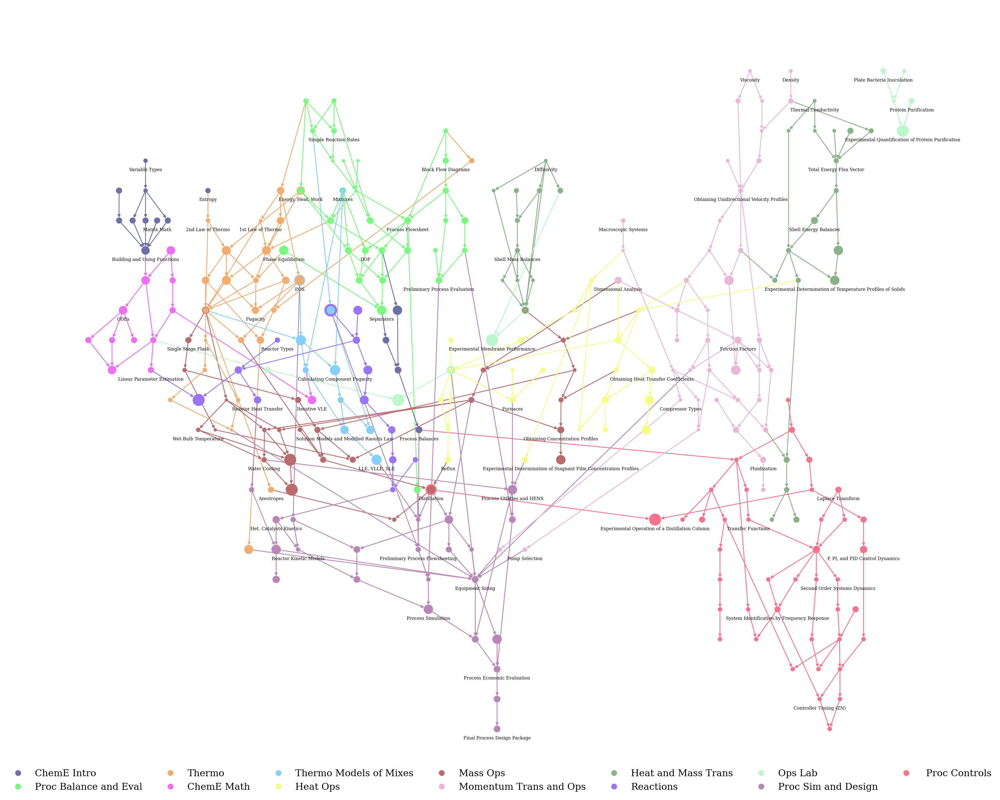

In [24]:
(topic_sequenced_modules, topic_sequenced_module_sizes, sequenced_module_size, sequenced_module_review_sizes, sequenced_module_reviewed_topics) = process_modules(sequenced_modules,sequenced_module_reviews)

n_modules = len(sequenced_modules)
colors = distinctipy.get_colors(n_modules,pastel_factor=0.7)
for i,color in enumerate(colors):
    colors[i] = mpl.colors.rgb2hex(color)
sequenced_module_colors = dict(zip(np.arange(0,n_modules,1),colors))

sequenced_module_figure = graph_module_nodes(pos_base,sequenced_module_colors,topic_sequenced_modules,topic_sequenced_module_sizes,"Curriculum Graphs/Core Topics-Sequenced Modules.pdf")

label_pos = {}
for node in graph.nodes:
    label_pos[node] = (pos_base[node][0], pos_base[node][1] - 22)
    
nodes_to_label = ['Block Flow Diagrams','Simple Reaction Rates','Heat Tramsfer Intro',
                  'Mixtures','Phase Equilibrium','Phase Equilibrium','Seperators','Process Balances','Energy, Heat, Work','Separators','DOF','Process Flowsheet',
                  'Matrix Math','Variable Types','ODEs','Linear Parameter Estimation','Building and Using Functions',
                  'Derivaitve Relationships','Entropy','1st Law of Thermo','EOS','Fugacity','Unit Entropy Balances''Reversible Carnot Cycle',
                  '2nd Law of Thermo','Solution Models and Modified Raoults Law','Iterative VLE','Calculating Component Fugacity','LLE, VLLE, SLE',
                  'Viscosity','Density','Thermal Conductivity','Diffusivity','Dimensional Analysis','Compressor Types','Macroscopic Systems','Friction Factors','Furnaces','Distillation','Single Stage Flash','Azeotropes','Adsoprtion Equipment','Obtaining Concentration Profiles','Water Cooling','Reflux','Obtaining Unidirectional Velocity Profiles','Total Energy Flux Vector','Shell Mass Balances','Fluidization','Pump Selection','Shell Energy Balances','Obtaining Heat Transfer Coefficients','Wet-Bulb Temperature',
                  'Experimental Determination of Temperature Profiles of Solids','Experimental Determination of Stagnant Film Concentration Profiles',
                  'Experimental Operation of a Distillation Column','Experimental Membrane Performance','Protein Purification','Plate Bacteria Inoculation','Experimental Quantification of Protein Purification',
                  'Reactor Heat Transfer','Het. Catalysts Kinetics','Reactor Types',
                  'Process Utilities and HENS','Preliminary Process Evaluation','Equipment Sizing','Process Simulation','Final Process Design Package','Process Economic Evaluation','Reactor Kinetic Models','Preliminary Process Flowsheeting',
                  'System Identification by Frequency Response','Emperical Process Modeling','Second Order Systems Dynamics','Laplace Transform','Transfer Functions','Controller Tuning (ZN)','P, PI, and PID Control Dynamics']
labels_to_display = {node: node for node in nodes_to_label if node in graph.nodes}
labels = nx.draw_networkx_labels(graph, label_pos,labels=labels_to_display, font_size=16, font_family='serif')

legend_elements = [Line2D([0], [0], marker='o', color=sequenced_module_color, label=sequenced_module_names_dict[module], lw=0,markerfacecolor=sequenced_module_color, markersize=20) for module,sequenced_module_color in sequenced_module_colors.items()]
font_props = fm.FontProperties(family='serif', size=34)
sequenced_module_figure.legend(handles=legend_elements, frameon=False, loc = "lower center", ncol=7,prop=font_props)

sequenced_module_figure.savefig("Curriculum Graphs/Core Topics-Sequenced Modules.pdf",format="pdf")

In [25]:
pos_sequenced_module = module_position(sequenced_modules,topic_sequenced_modules)

for k,i in enumerate(graph.nodes()):
    net.get_node(i)['x'] = pos_sequenced_module[i][0]
    net.get_node(i)['y'] = -pos_sequenced_module[i][1]
    net.get_node(i)['borderWidth'] = 0
    net.get_node(i)['color'] = sequenced_module_colors[topic_sequenced_modules[i][0]]
    if i in reviewed_topics:
        net.get_node(i)['borderWidth'] = (sum(topic_sequenced_module_sizes[i]) - topic_sizes[i])*50

net.save_graph('Curriculum Graphs/Core Topics-Sequenced Modules.html')

Modules form a directed acyclic graph


Modules form a directed acyclic graph


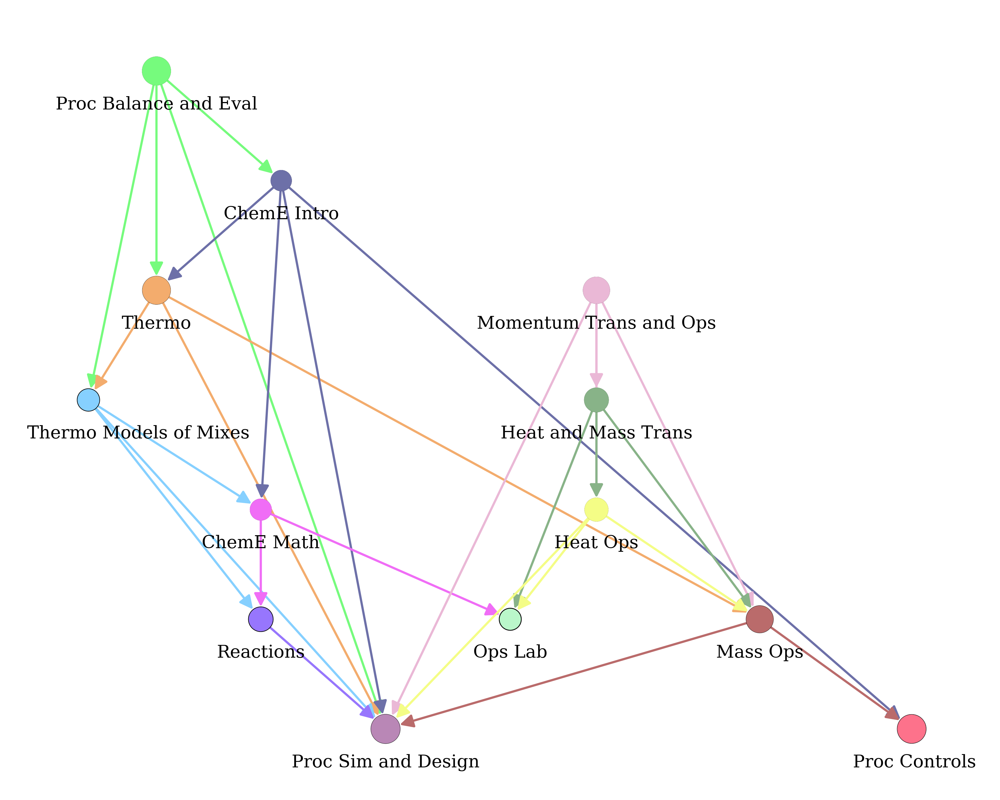

In [26]:
sequenced_modules_modules_figure = graph_modules(sequenced_modules,sequenced_module_colors,topic_sequenced_modules,dict(zip(np.arange(0,len(modules),1),sequenced_module_size)),
                                                 "Curriculum Graphs/Core Topics-Sequenced Module Nodes.pdf",sequenced_module_names_dict)

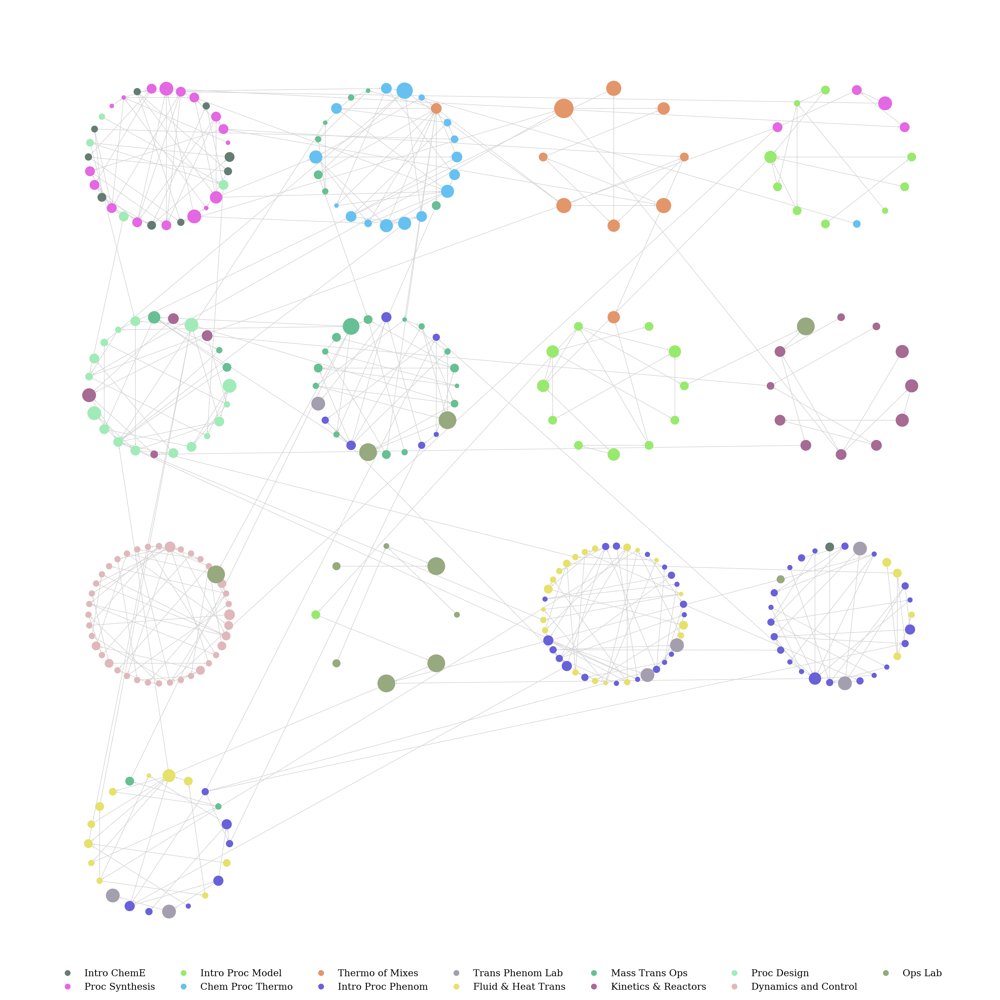

In [27]:
hypergraph = nx.DiGraph()
for k, (i, j) in enumerate(graph.edges()):
    p = topic_sequenced_modules[i][0]
    q = topic_sequenced_modules[j][0]
    if p != q:
        hypergraph.add_edge(p, q)

hypergraph_pos = nx.nx_agraph.graphviz_layout(hypergraph, prog='osage')

pos_nodes = dict()
for topics in sequenced_modules:
    subgraph = graph.subgraph(topics)
    pos_subgraph = nx.circular_layout(subgraph)
    pos_nodes.update(pos_subgraph)

pos_sequenced_module = dict()
for topics in sequenced_modules:
    for i in topics:
        pos_sequenced_module[i] = (hypergraph_pos[topic_sequenced_modules[i][0]][0] + 18*pos_nodes[i][0], 
                                   hypergraph_pos[topic_sequenced_modules[i][0]][1] + 12*pos_nodes[i][1]) 

node_size = [sum(topic_sequenced_module_sizes[i]) for i in graph.nodes()]
sequenced_modules_figure_grouped = plt.figure(figsize=(50,50))

nx.draw(graph, pos_sequenced_module, node_size=[8000*v for v in node_size], node_color=[course_colors[topic_courses[i][0]] for i in graph.nodes()], arrowsize=10, width=2, edge_color='#D3D3D3')

legend_elements = [Line2D([0], [0], marker='o', color=course_color, label=course_names_short[course], lw=0,markerfacecolor=course_color, markersize=20) for course,course_color in course_colors.items()]
font_props = fm.FontProperties(family='serif', size=34)
sequenced_modules_figure_grouped.legend(handles=legend_elements, frameon=False, loc = "lower center", ncol=7,prop=font_props)

sequenced_modules_figure_grouped.savefig("Curriculum Graphs/Core Topics-Sequenced Modules Grouped (Course Names).pdf",format="pdf")

## Community Detection

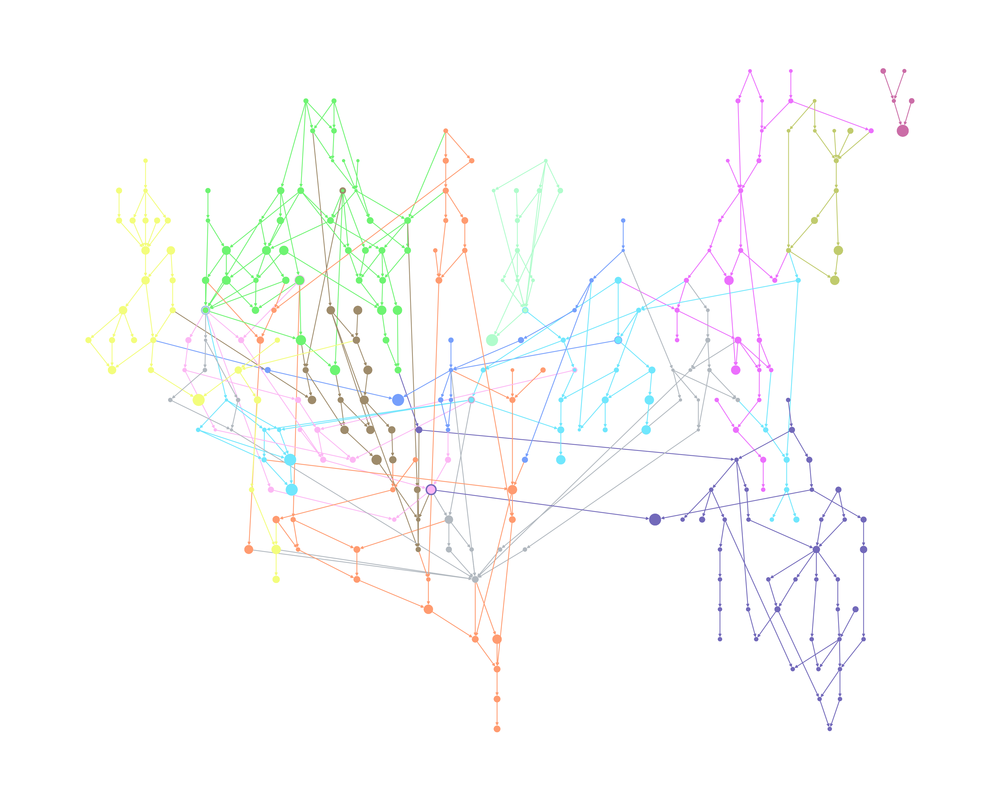

In [28]:
communities = nx.community.greedy_modularity_communities(graph, cutoff = 13, best_n=13)

community_reviews = []
for community in communities:
    for i in community:
        for j in graph.nodes():
            if (i,j) in simple_review_sizes.keys():
                if j not in community:
                    community_reviews.append([i,j])

(topic_communities, topic_communities_sizes, community_size, community_review_sizes, community_reviewed_topics) = process_modules(communities,community_reviews)

n_modules = len(communities)
colors = distinctipy.get_colors(n_modules,pastel_factor=0.7)
for i,color in enumerate(colors):
    colors[i] = mpl.colors.rgb2hex(color)
community_colors = dict(zip(np.arange(0,n_modules,1),colors))

community_figure = graph_module_nodes(pos_base,community_colors,topic_communities,topic_communities_sizes,"Curriculum Graphs/Core Topics-Communities.pdf")

# Comparision

In [29]:
print(sum(data["Credits"].tolist()))
print(data["Credits"].tolist())
print(round(nx.community.modularity(graph,list(course_topics.values())),3))
print(round(calc_modularity(list(course_topics.values())),3))
print(len(reviewed_topics))
print(round(total_review_size(topic_course_sizes),3))

40
[1, 3, 3, 3, 3, 4, 3, 3, 3, 3, 3, 3, 5]
0.678
0.39
40
4.1


In [30]:
print(round(sum(module_size),2))
print([round(value, 2) for value in module_size])
print(round(nx.community.modularity(graph,modules),3))
print(round(calc_modularity(modules),3))
print(len(module_reviewed_topics))
print(round(total_review_size(topic_module_sizes),3))

38.18
[2.85, 3.22, 3.13, 2.82, 2.97, 3.09, 3.22, 2.99, 2.47, 2.85, 3.04, 2.79, 2.74]
0.75
0.417
21
2.28


In [31]:
print(round(sum(sequenced_module_size),2))
print([round(value, 2) for value in sequenced_module_size])
print(round(nx.community.modularity(graph,sequenced_modules),3))
print(round(calc_modularity(sequenced_modules),3))
print(len(sequenced_module_reviewed_topics))
print(round(total_review_size(topic_sequenced_module_sizes),3))

37.27
[1.92, 3.58, 3.51, 2.04, 2.28, 2.44, 3.29, 3.15, 2.61, 2.75, 2.22, 3.78, 3.7]
0.753
0.424
9
1.37


In [32]:
print(round(sum(community_size),2))
print([round(value, 2) for value in community_size])
print(round(nx.community.modularity(graph,communities),3))
print(round(calc_modularity(communities),3))
print(len(community_reviewed_topics))
print(round(total_review_size(topic_communities_sizes),3))

36.79
[3.85, 6.31, 4.24, 4.31, 2.45, 4.4, 1.45, 3.33, 1.49, 1.68, 1.2, 1.28, 0.8]
0.765
0.434
8
0.89
